In [1]:
import palantir
import scanpy as sc
import pandas as pd
import os

# Plotting
import matplotlib
import matplotlib.pyplot as plt

# warnings
import warnings
from numba.core.errors import NumbaDeprecationWarning

warnings.filterwarnings(action="ignore", category=NumbaDeprecationWarning)
warnings.filterwarnings(
    action="ignore", module="scanpy", message="No data for colormapping"
)

# Inline plotting
%matplotlib inline

import cellrank as cr

sc.settings.set_figure_params(frameon=False, dpi=100)
cr.settings.verbosity = 2

import numpy as np
import scvelo as scv

scv.settings.verbosity = 3
scv.settings.set_figure_params("scvelo")

In [147]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt02.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)


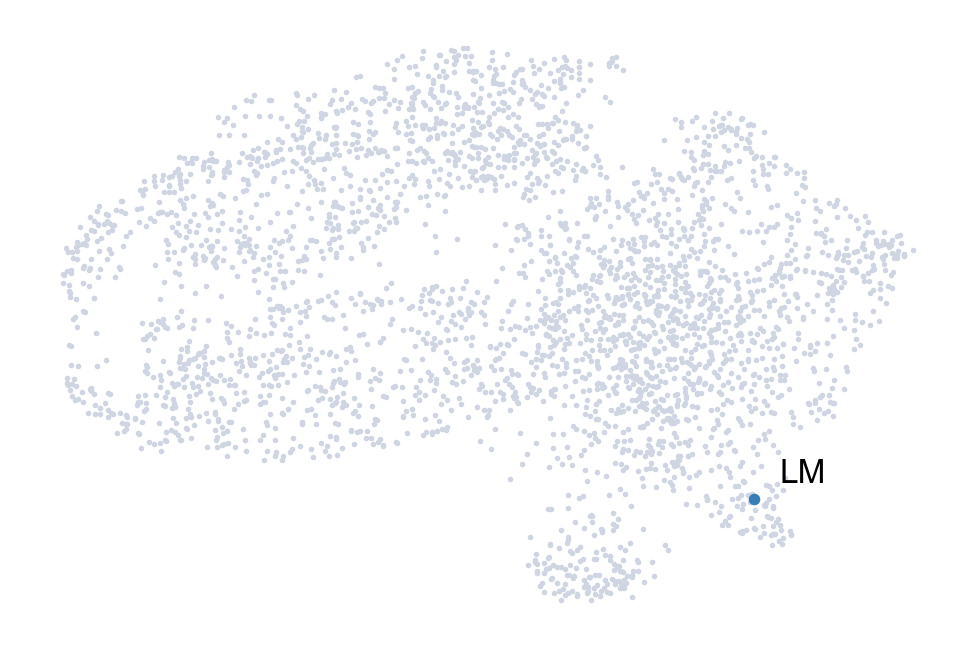

In [148]:
terminal_states = pd.Series(
    ["LM"],
    index=["X5204-3_GTCACGGCAAACTGCT-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [149]:
start_cell = "X5204-4_ACATACGGTACCATCA-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.002498884995778402 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.11492016712824503 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9997
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


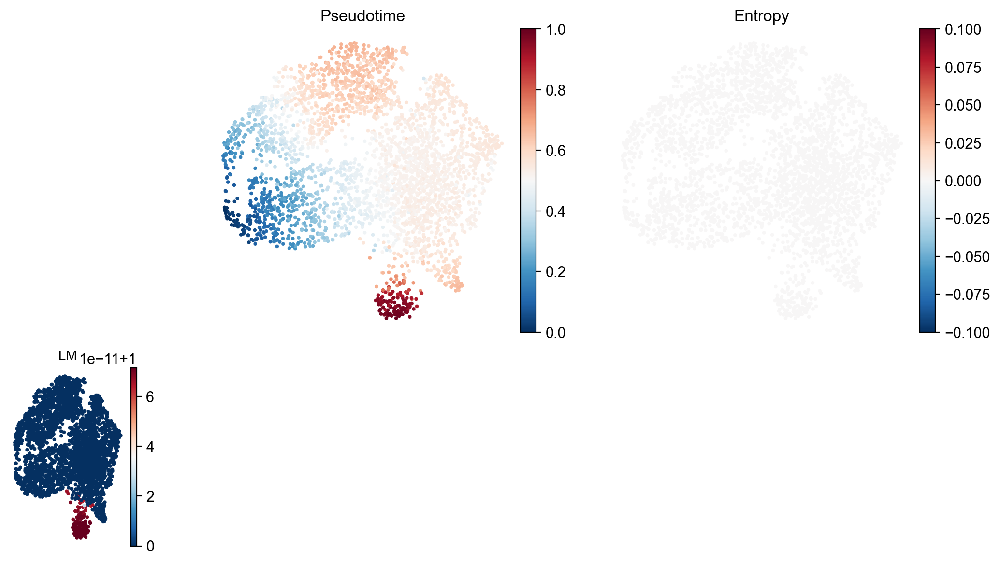

In [150]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

In [151]:
sc.tl.diffmap(ad)

In [152]:
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)

Computing transition matrix based on pseudotime


  0%|          | 0/3263 [00:00<?, ?cell/s]

    Finish (0:00:01)
PseudotimeKernel[n=3263]


Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


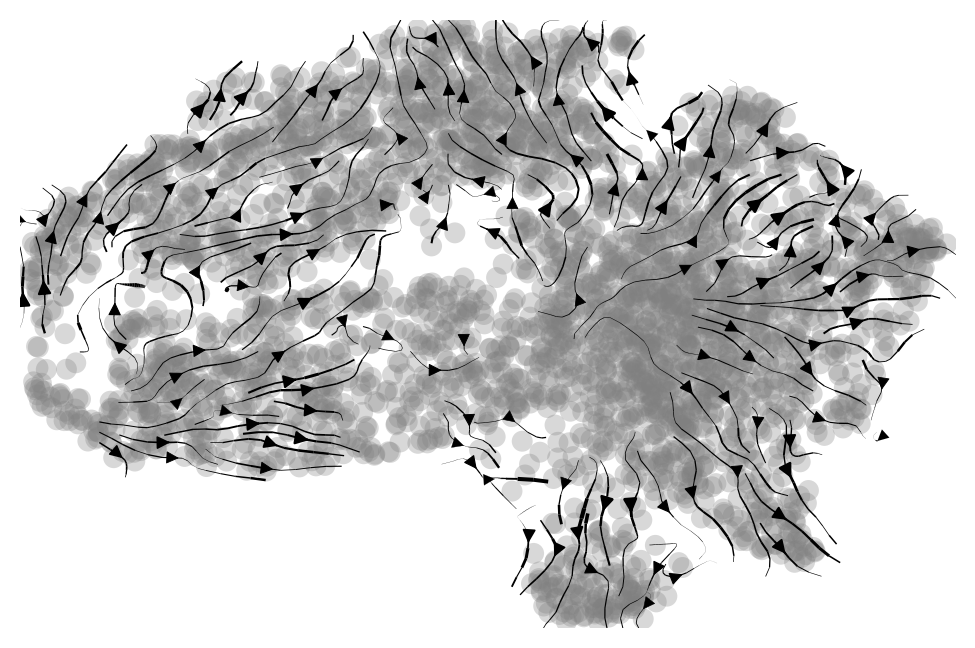

In [153]:
pk.plot_projection(basis="umap", recompute=True)

In [9]:
g = cr.estimators.GPCCA(pk)
print(g)

GPCCA[kernel=PseudotimeKernel[n=3263], initial_states=None, terminal_states=None]


Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:13)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


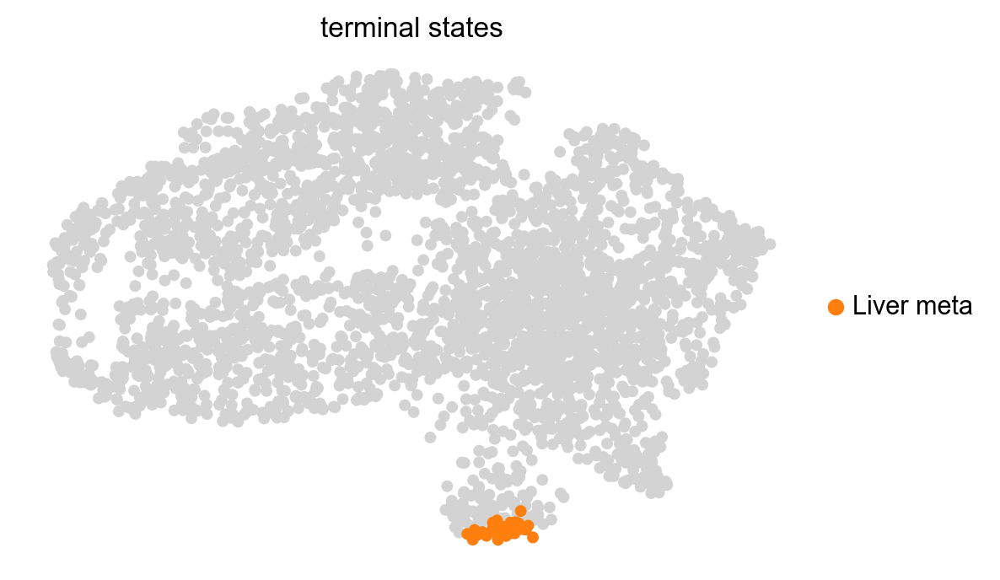

In [10]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities
Defaulting to `'gmres'` solver.


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt02_cellrank.pdf


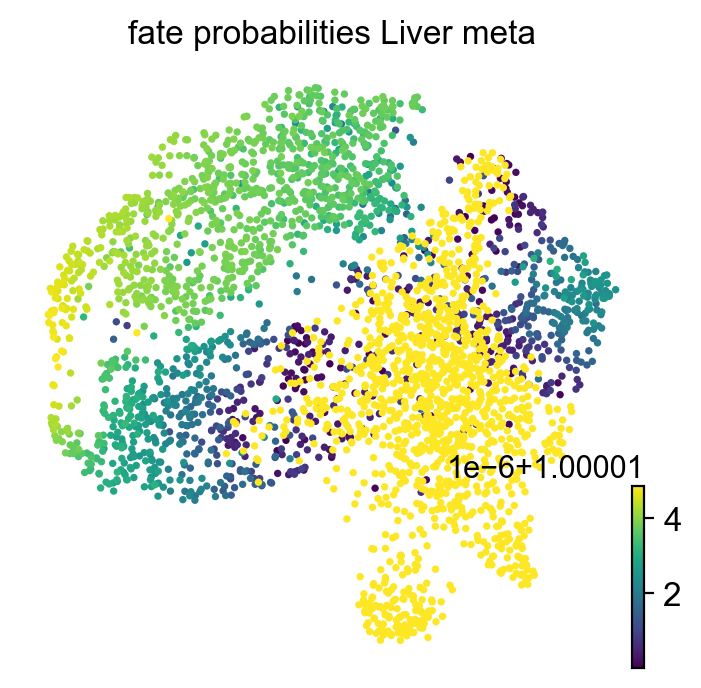

In [11]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt02_cellrank.pdf',figsize=(4,4))

In [12]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt02_cellrank.csv')

In [13]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt01.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

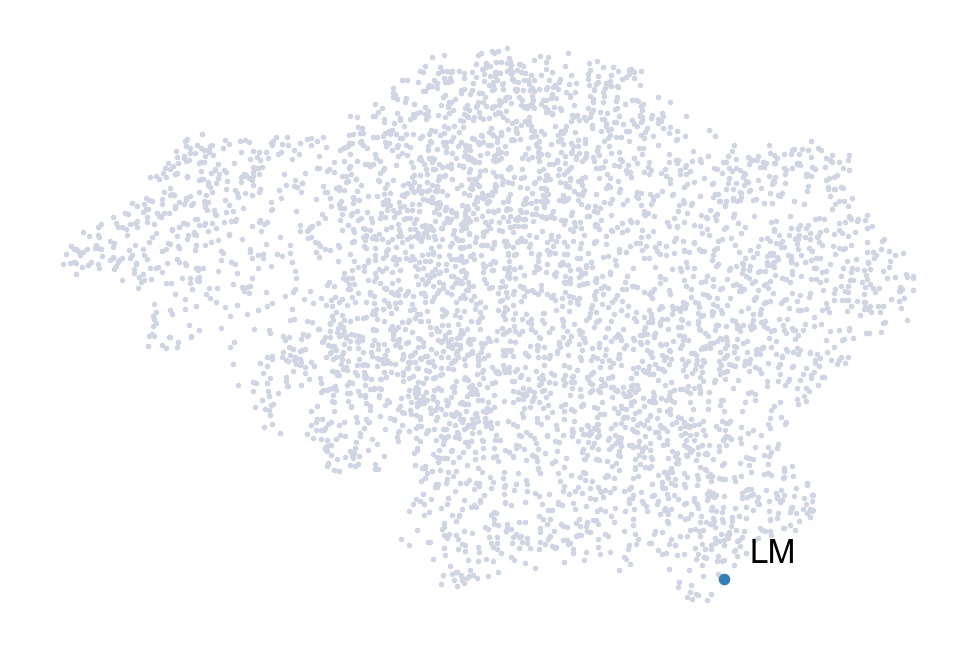

In [14]:
terminal_states = pd.Series(
    ["LM"],
    index=["W5213-2_TTCTCAAGTTGGTGGA-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [15]:
start_cell = "W5213-1_TTATGCTTCCTTAATC-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.0034981528917948407 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.13475073178609212 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9991
Correlation at iteration 2: 0.9999
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


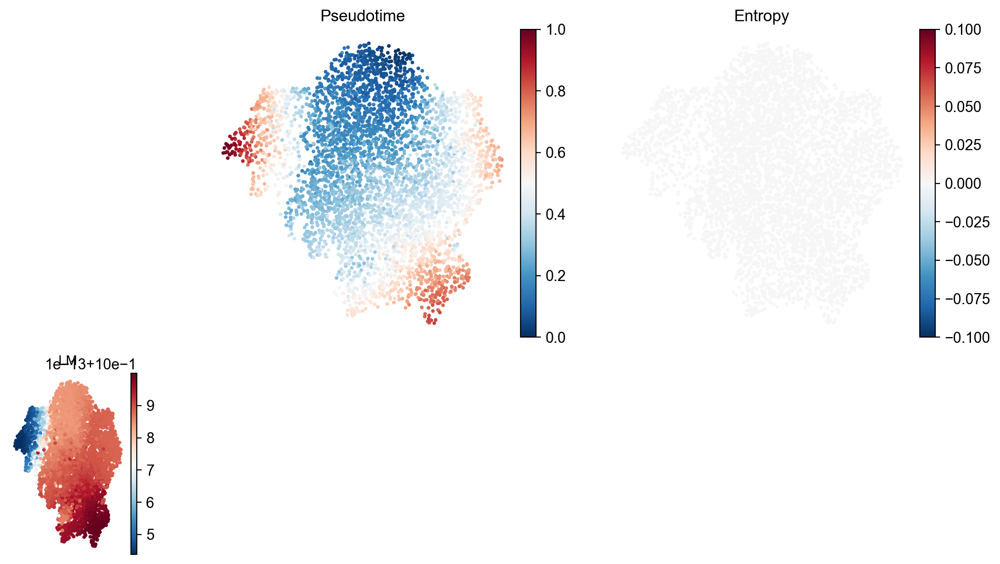

In [16]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/4340 [00:00<?, ?cell/s]

    Finish (0:00:01)
PseudotimeKernel[n=4340]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:01)


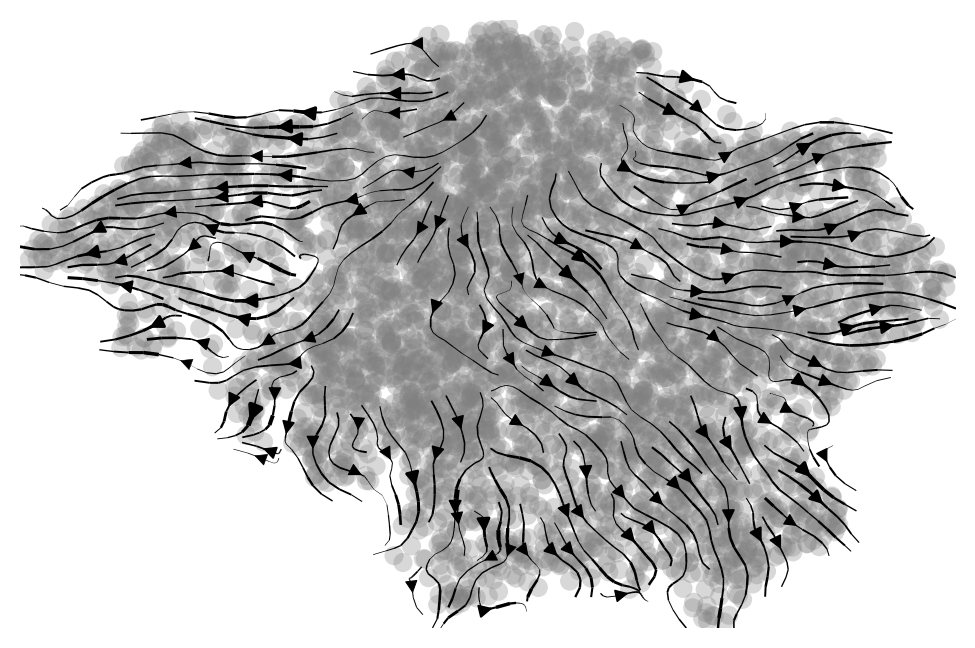

GPCCA[kernel=PseudotimeKernel[n=4340], initial_states=None, terminal_states=None]


In [17]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:27)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:01)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


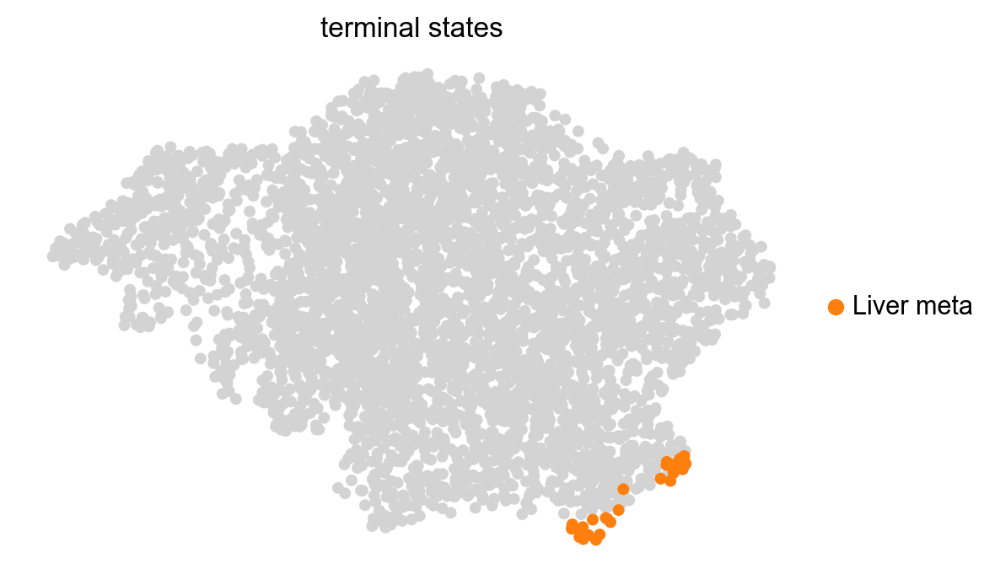

In [18]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt01_cellrank.pdf


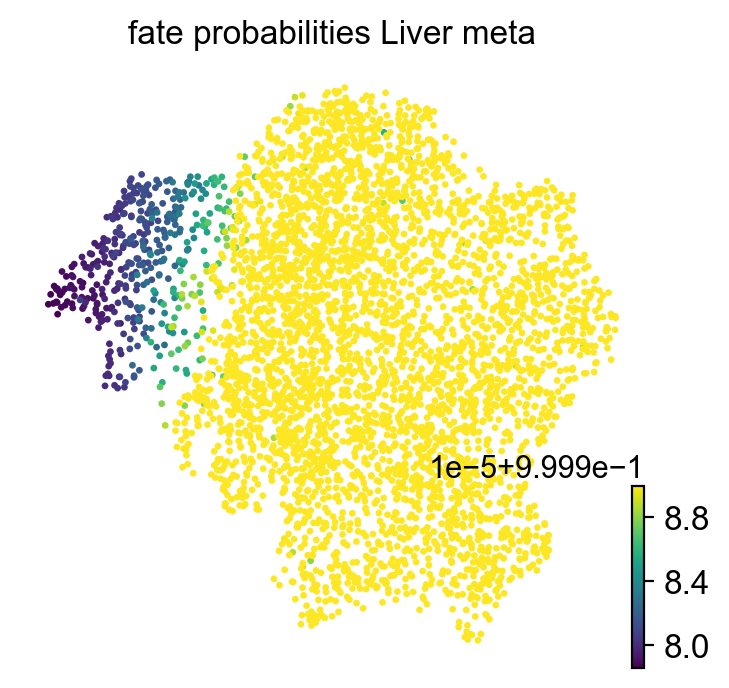

In [19]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt01_cellrank.pdf',figsize=(4,4))

In [20]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt01_cellrank.csv')

In [21]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt03.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=10)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

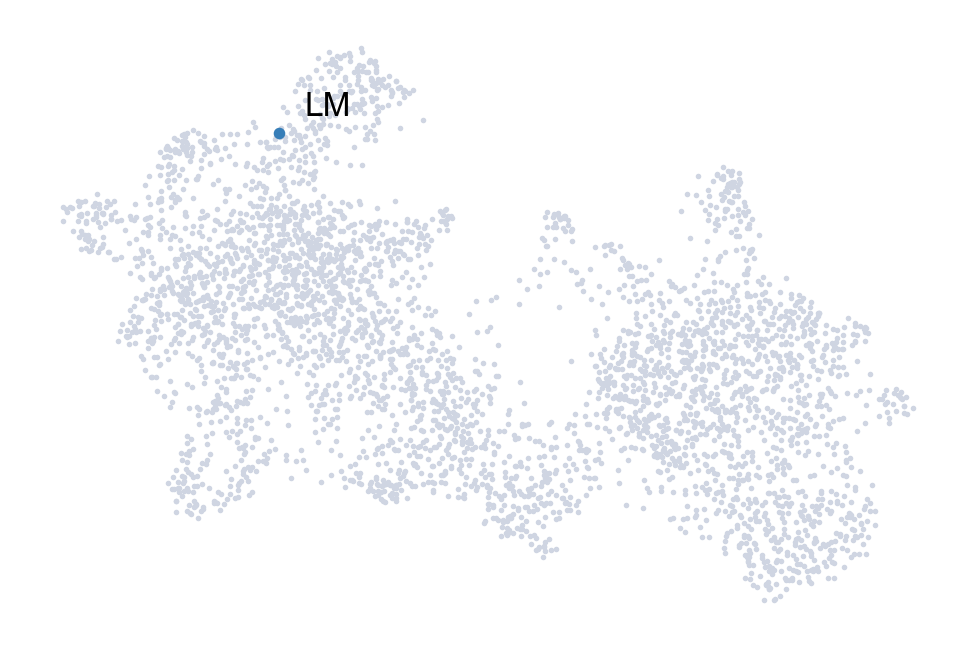

In [22]:
terminal_states = pd.Series(
    ["LM"],
    index=["X5207-1_CACTCCACATGTTCCC-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [23]:
start_cell = "X5207-2_TTAACTCAGTGTTAGA-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.001883383591969808 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.13284607728322348 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9992
Correlation at iteration 2: 0.9999
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


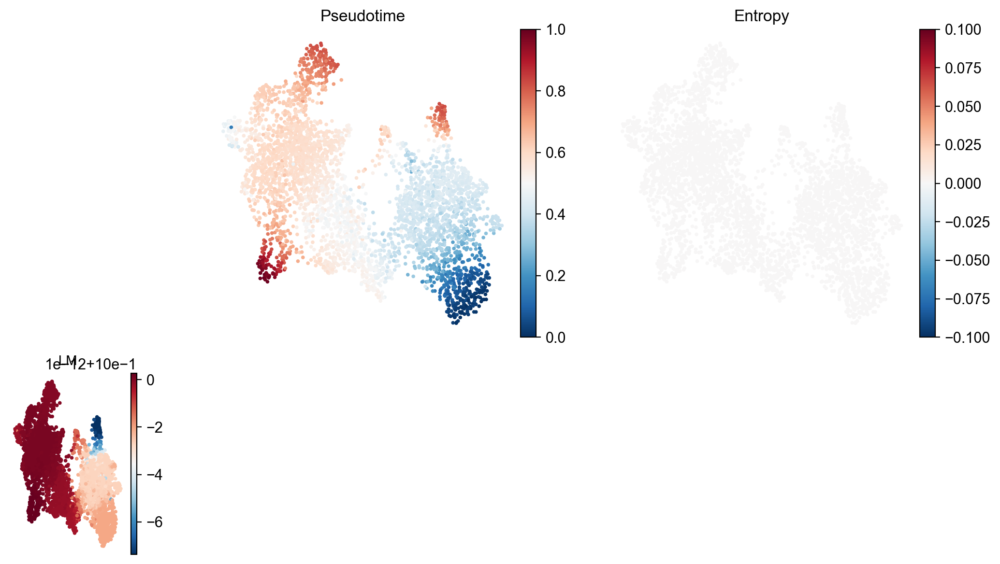

In [24]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/4048 [00:00<?, ?cell/s]

    Finish (0:00:01)
PseudotimeKernel[n=4048]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:01)


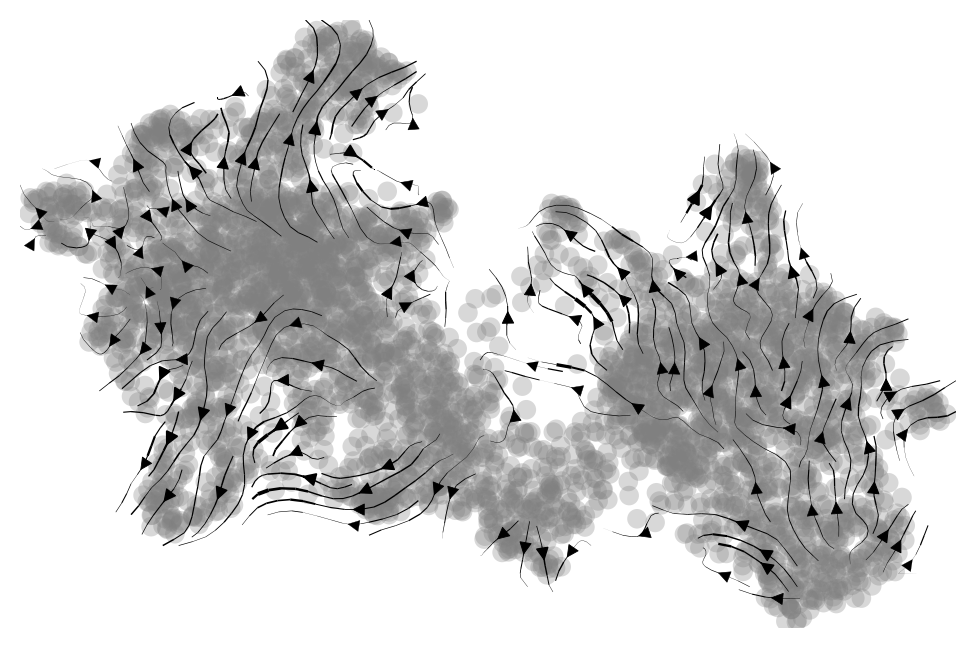

GPCCA[kernel=PseudotimeKernel[n=4048], initial_states=None, terminal_states=None]


In [25]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:22)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


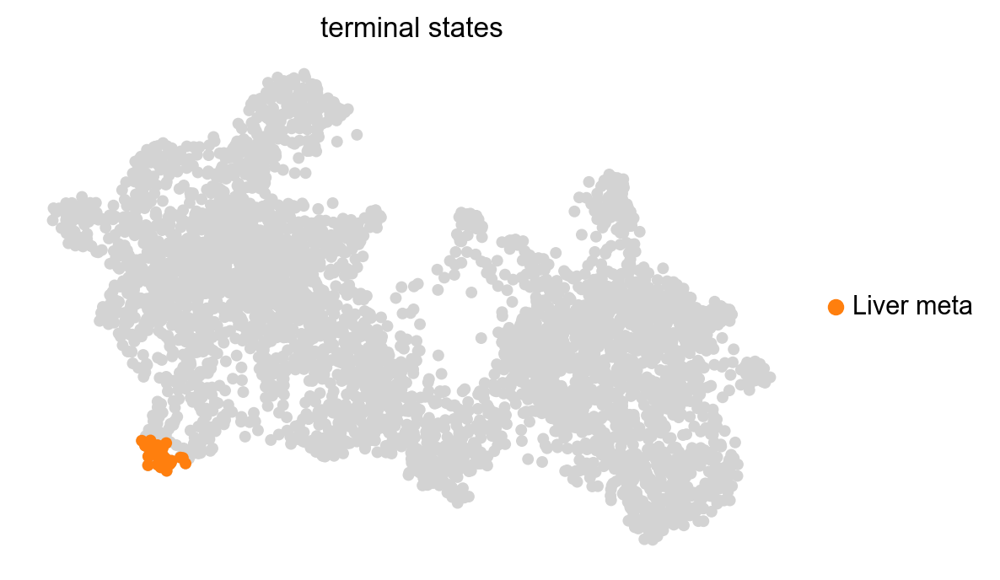

In [26]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt03_cellrank.pdf


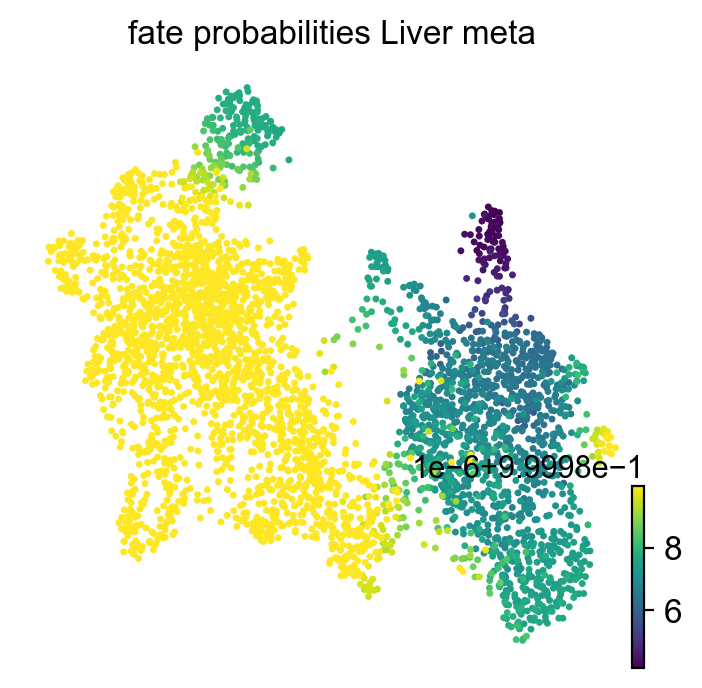

In [27]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt03_cellrank.pdf',figsize=(4,4))

In [28]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt03_cellrank.csv')

In [29]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt04.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

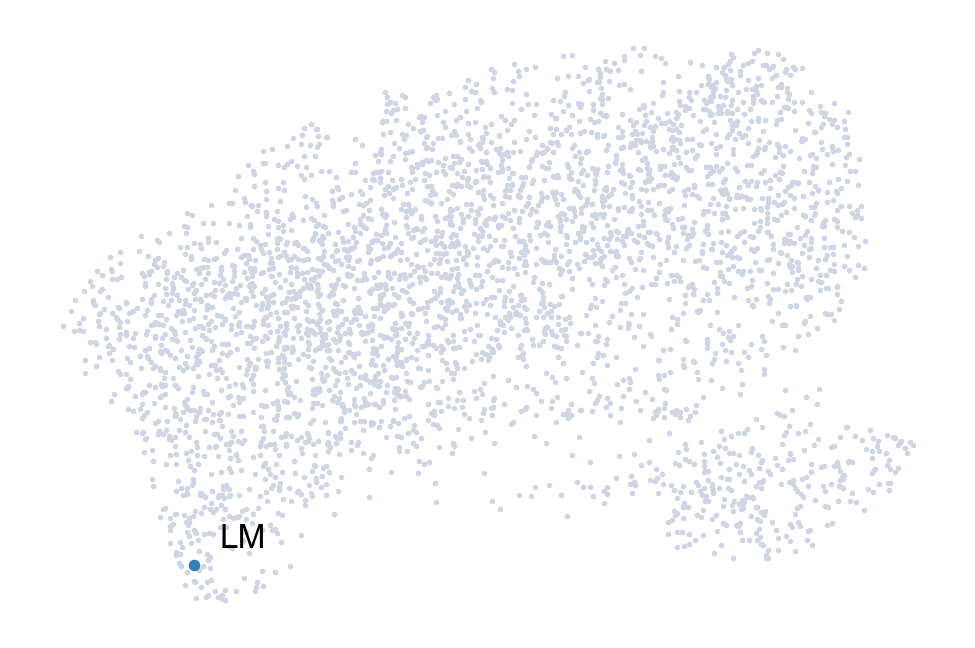

In [30]:
terminal_states = pd.Series(
    ["LM"],
    index=["X5209-2_GACTAACTCACTGGGC-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [31]:
start_cell = "X5208-2_TACGGTAGTGTTCTTT-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.003201198577880859 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.1244003693262736 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9995
Correlation at iteration 2: 0.9999
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


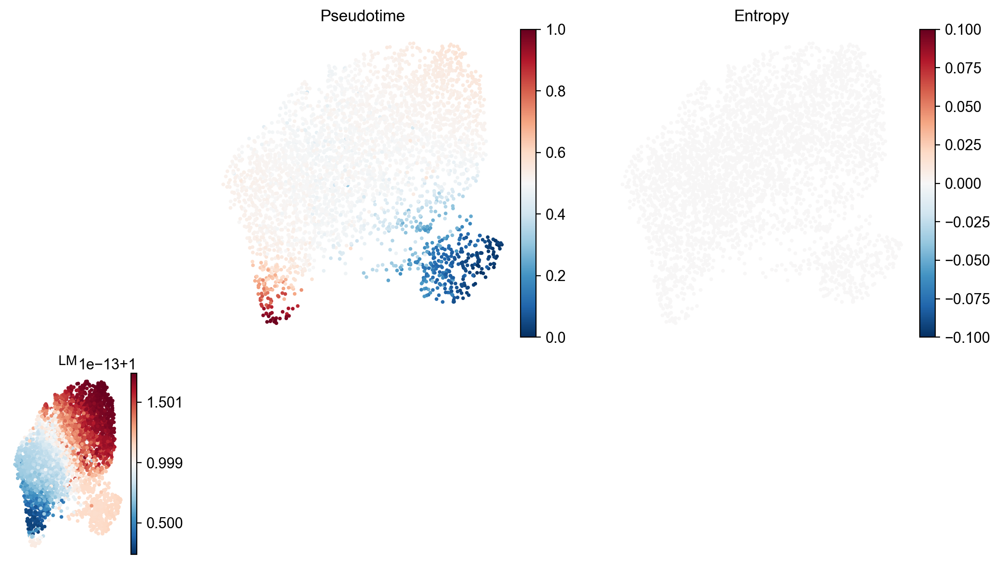

In [32]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/3745 [00:00<?, ?cell/s]

    Finish (0:00:01)
PseudotimeKernel[n=3745]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:01)


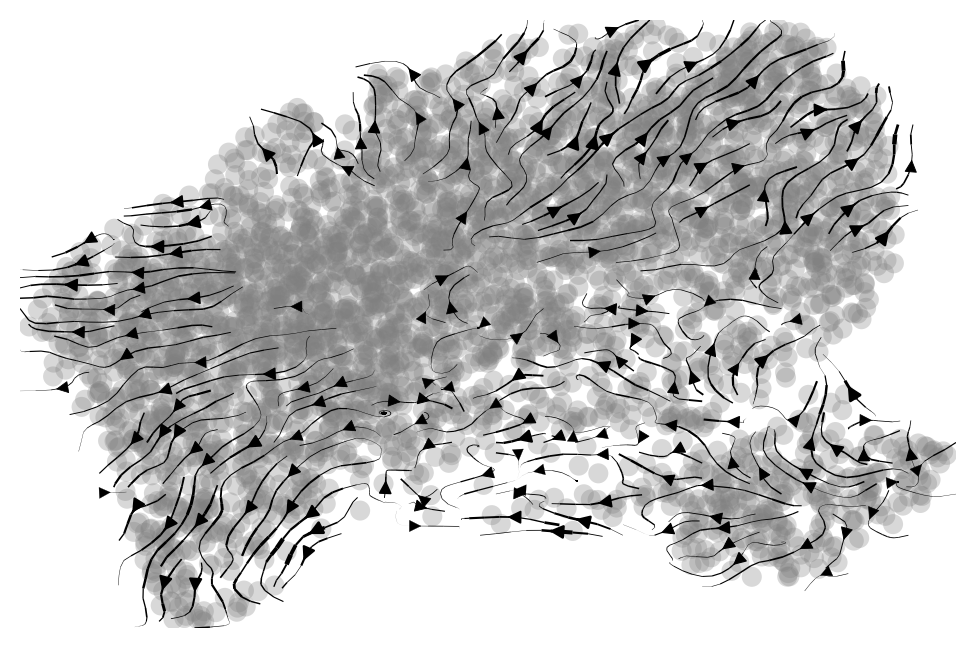

GPCCA[kernel=PseudotimeKernel[n=3745], initial_states=None, terminal_states=None]


In [33]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:17)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


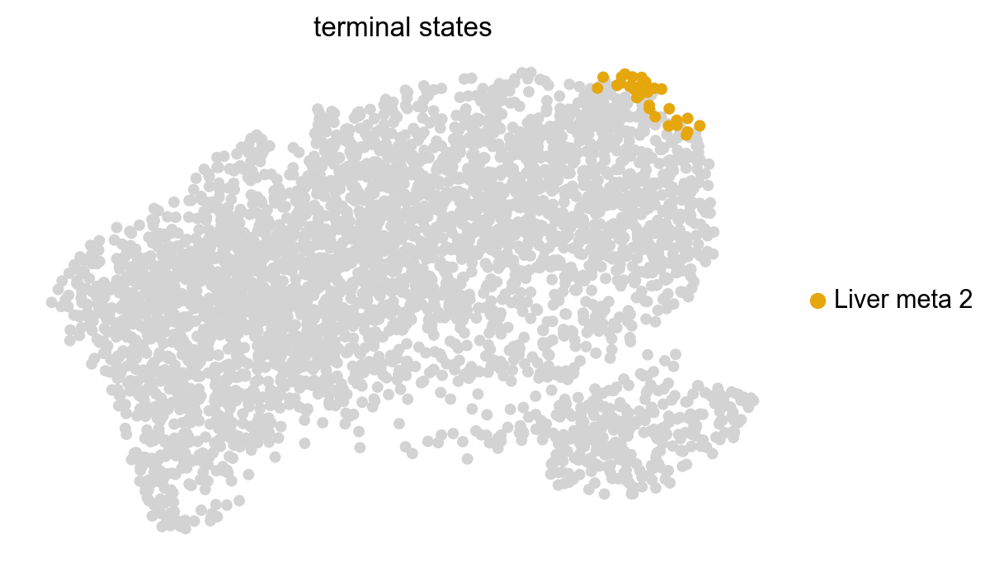

In [37]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta_2"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt04_cellrank.pdf


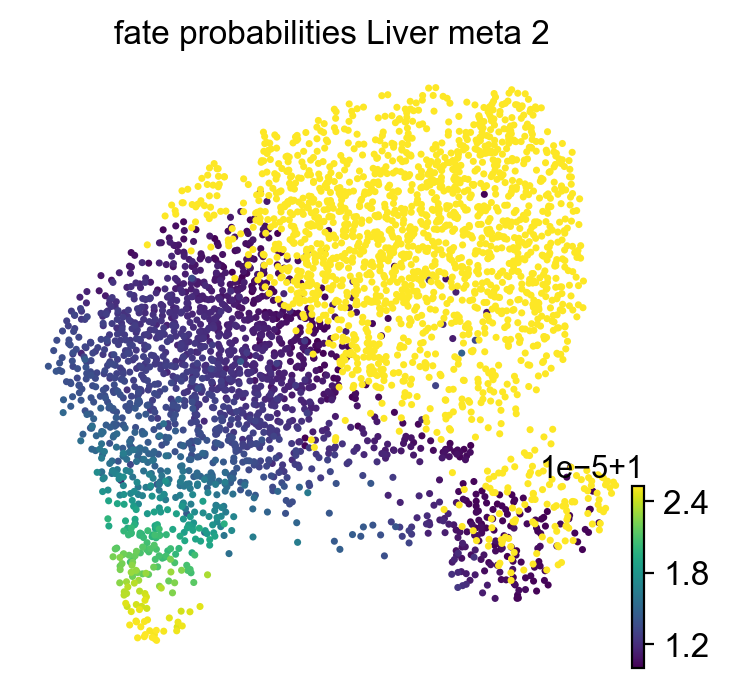

In [38]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt04_cellrank.pdf',figsize=(4,4))

In [39]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt04_cellrank.csv')

In [40]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt05.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=10)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

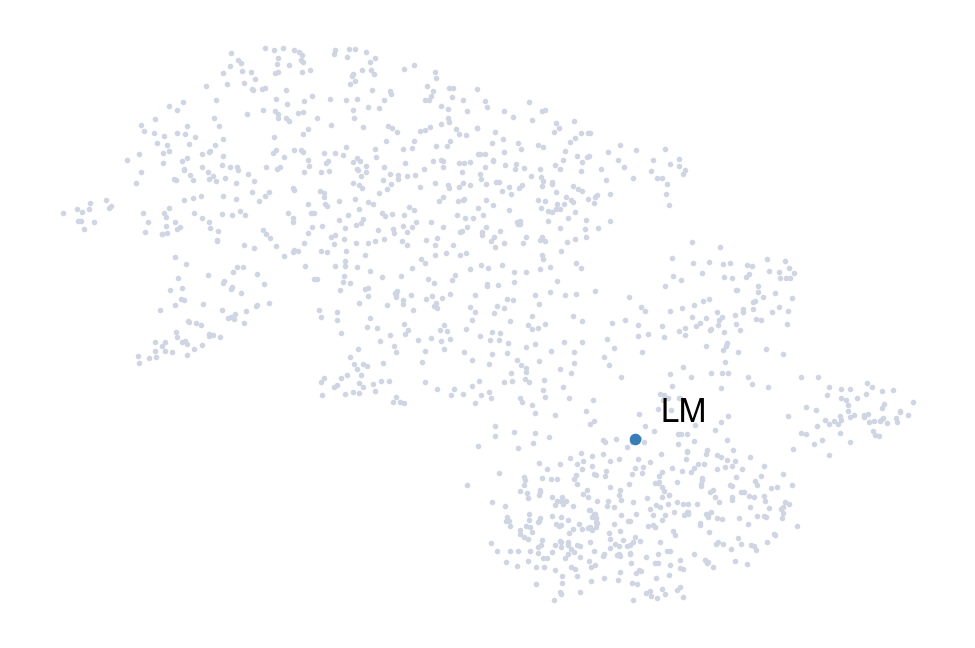

In [41]:
terminal_states = pd.Series(
    ["LM"],
    index=['X5210-2_CTCGGGACACCGAATT-1'],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [42]:
start_cell = "X5210-1_TACTCGCTCCTAGGGC-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.0009017149607340495 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.1093373974164327 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9980
Correlation at iteration 2: 0.9999
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


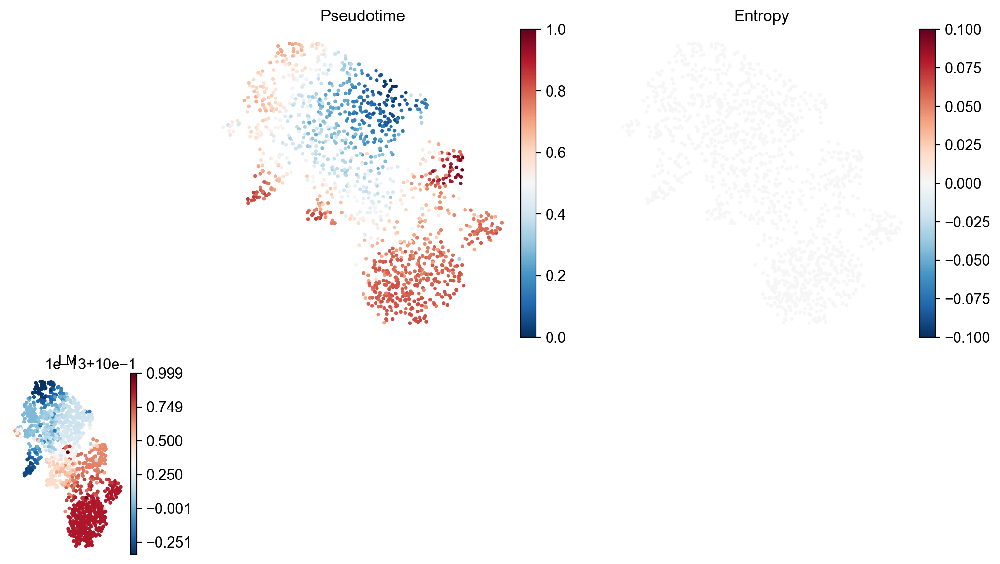

In [43]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/1263 [00:00<?, ?cell/s]

    Finish (0:00:00)
PseudotimeKernel[n=1263]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


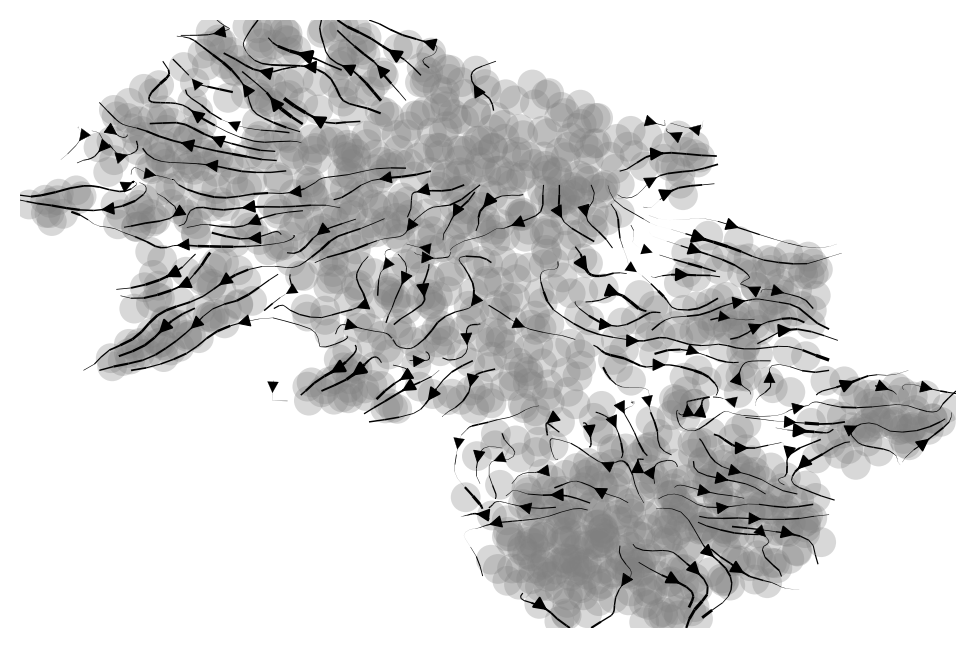

GPCCA[kernel=PseudotimeKernel[n=1263], initial_states=None, terminal_states=None]


In [44]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:01)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


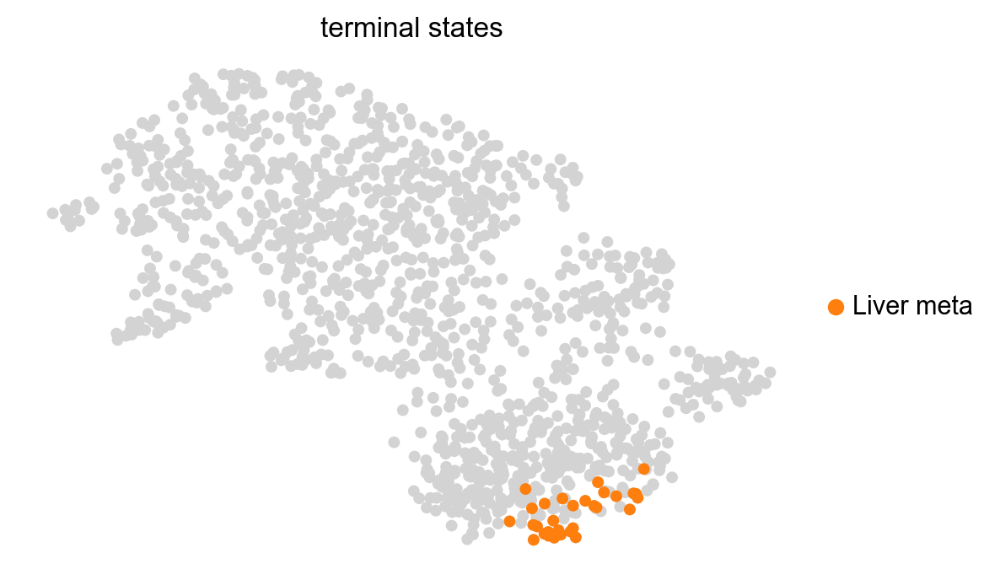

In [45]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt05_cellrank.pdf


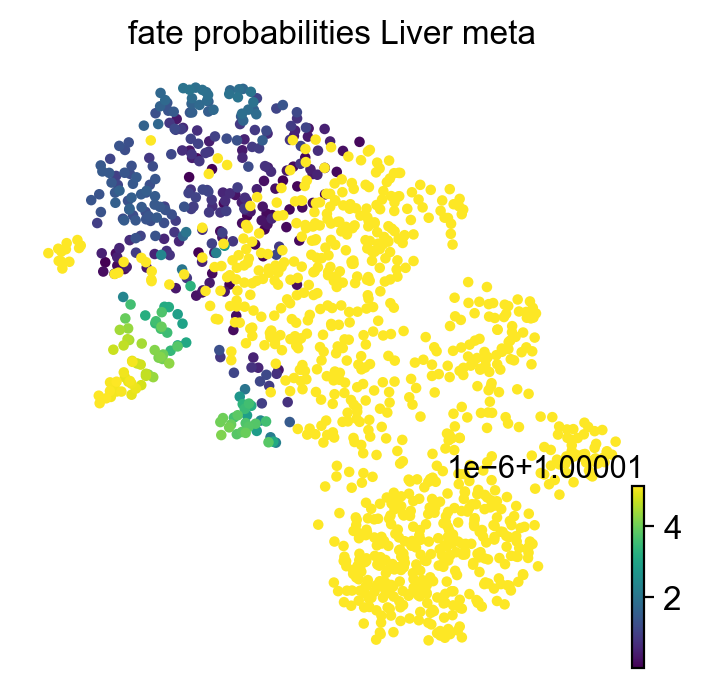

In [46]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt05_cellrank.pdf',figsize=(4,4))

In [47]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt05_cellrank.csv')

In [48]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt06.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

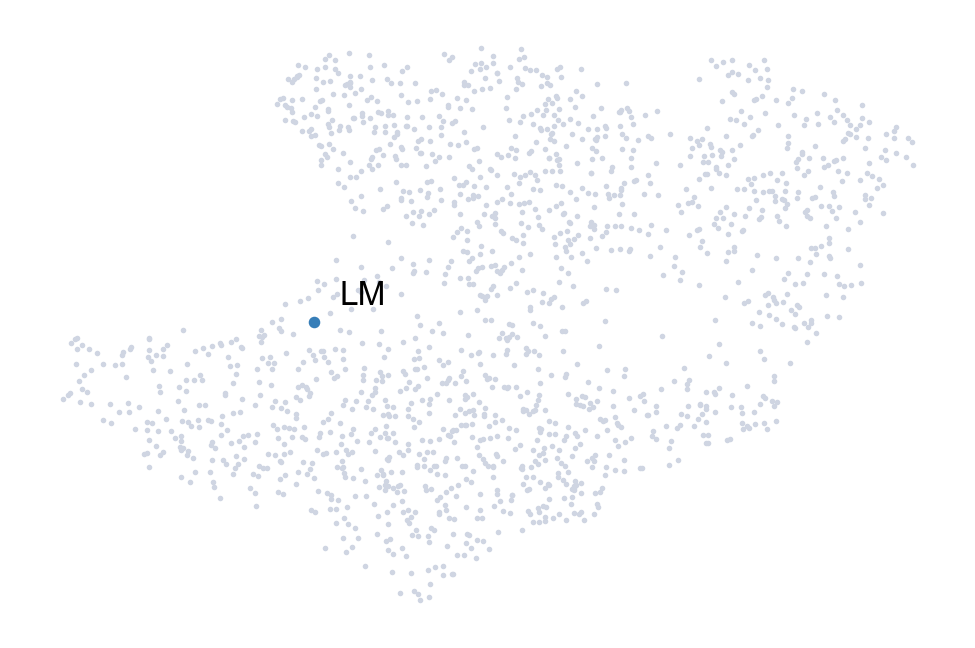

In [49]:
terminal_states = pd.Series(
    ["LM"],
    index=["X5211-5_CTCATTACATCCGGGT-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [50]:
start_cell = "X5211-3_GATGAAAGTGTGACGA-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.0013206005096435547 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.10604031880696614 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9997
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


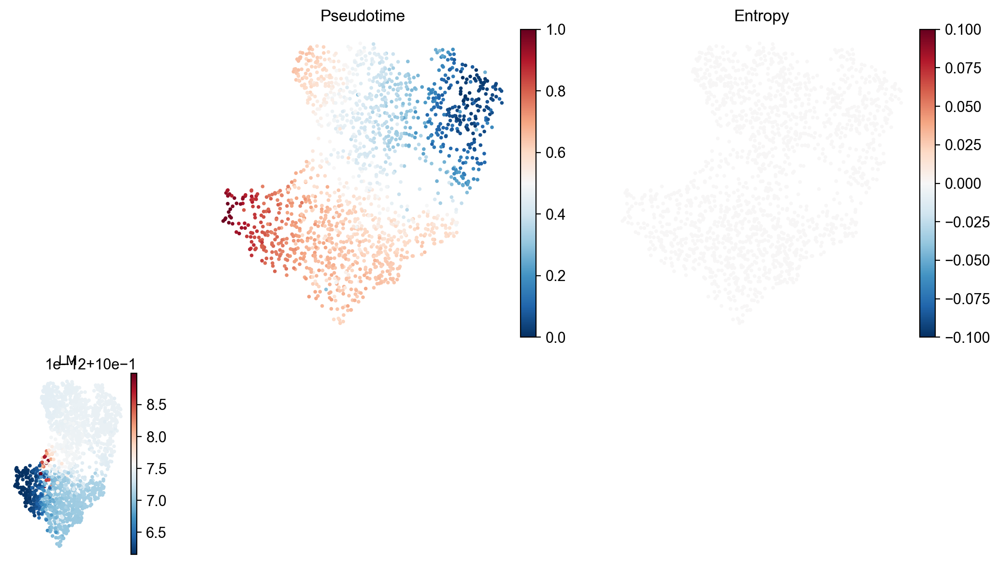

In [51]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/1650 [00:00<?, ?cell/s]

    Finish (0:00:00)
PseudotimeKernel[n=1650]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


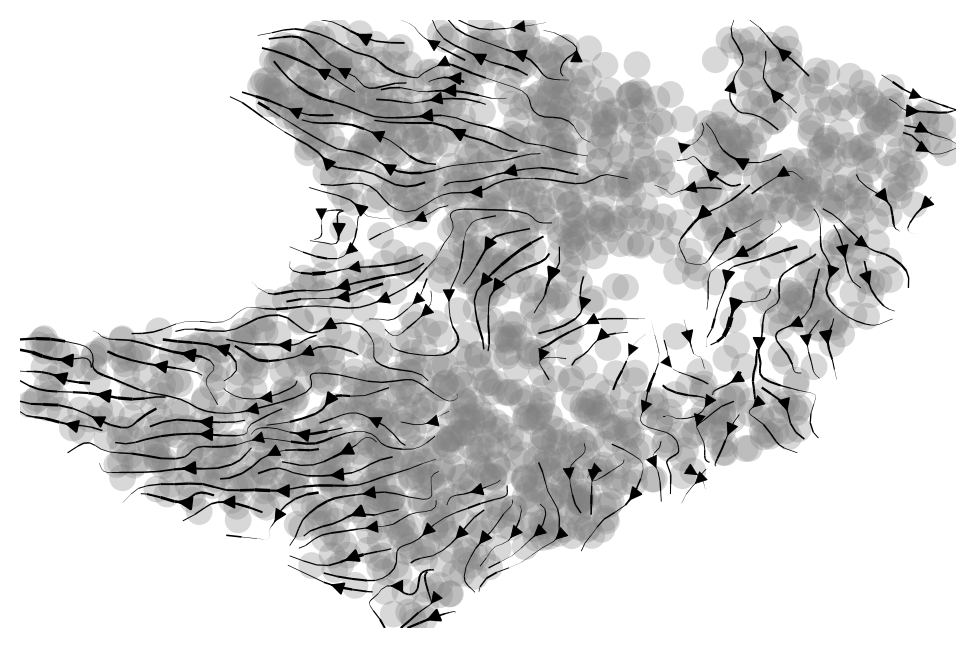

GPCCA[kernel=PseudotimeKernel[n=1650], initial_states=None, terminal_states=None]


In [52]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:02)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


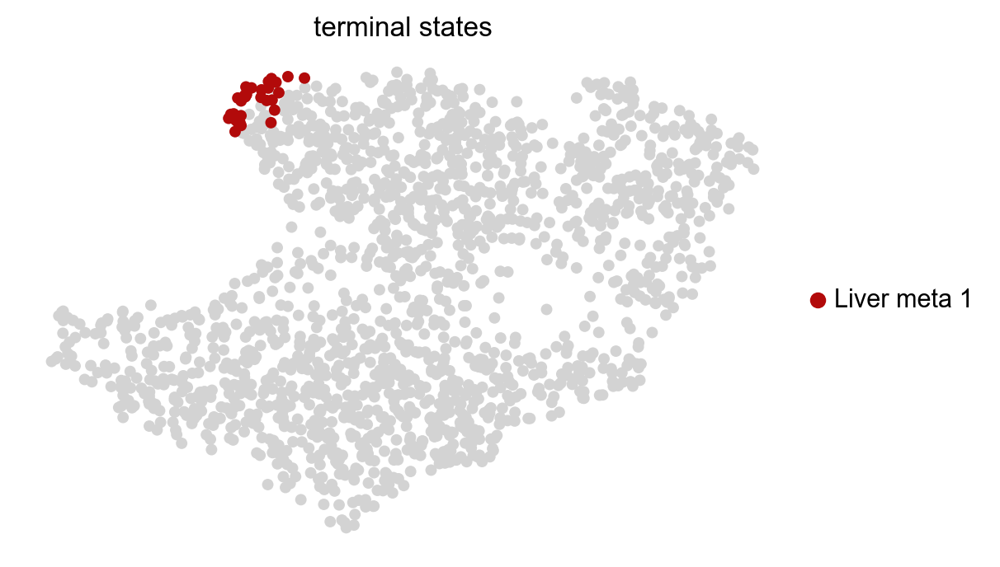

In [58]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta_1"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt06_cellrank.pdf


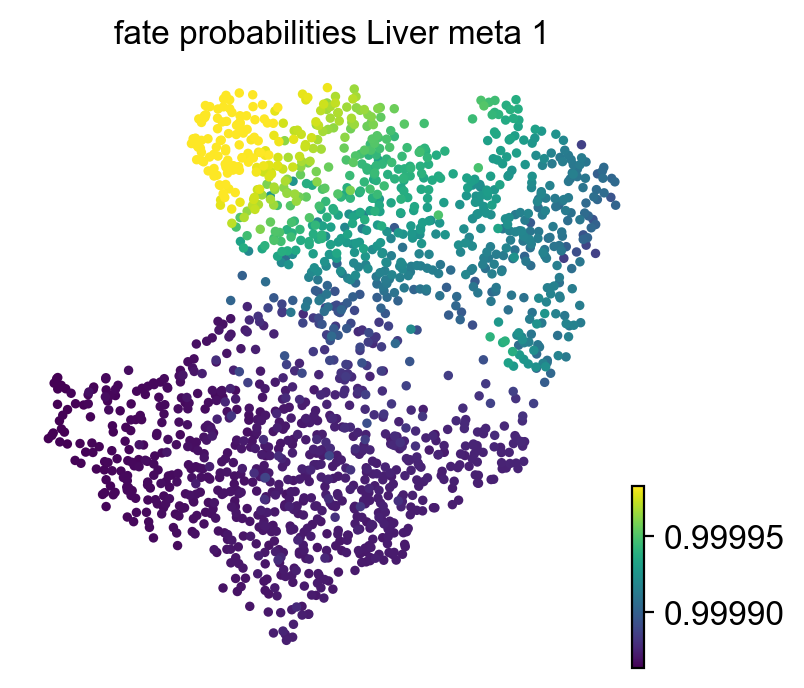

In [59]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt06_cellrank.pdf',figsize=(4,4))

In [60]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt06_cellrank.csv')

In [61]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt07.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

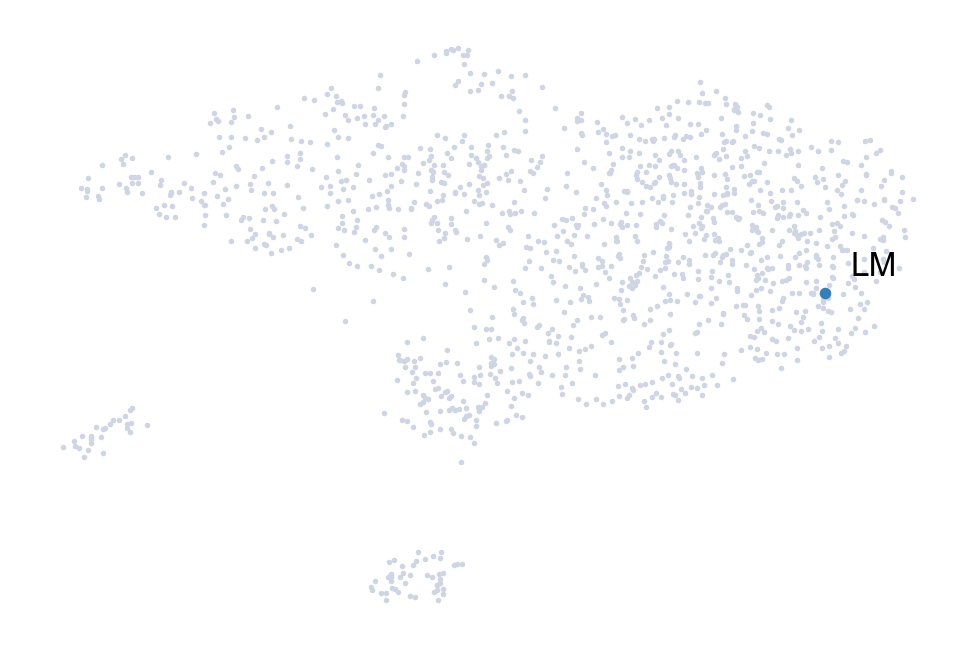

In [62]:
terminal_states = pd.Series(
    ["LM"],
    index=['X5225-11_CGCTGGATCGGTTCGG-1'],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [63]:
start_cell = "X5225-10_CATGCCTAGAGTTGGC-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.0010963638623555502 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.10405855178833008 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9999
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


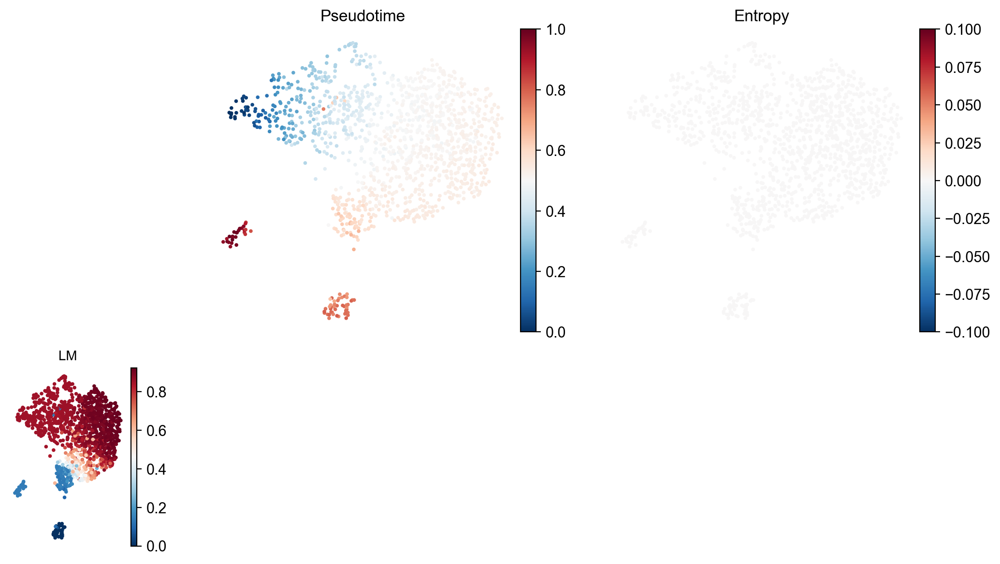

In [64]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/1322 [00:00<?, ?cell/s]

    Finish (0:00:00)
PseudotimeKernel[n=1322]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


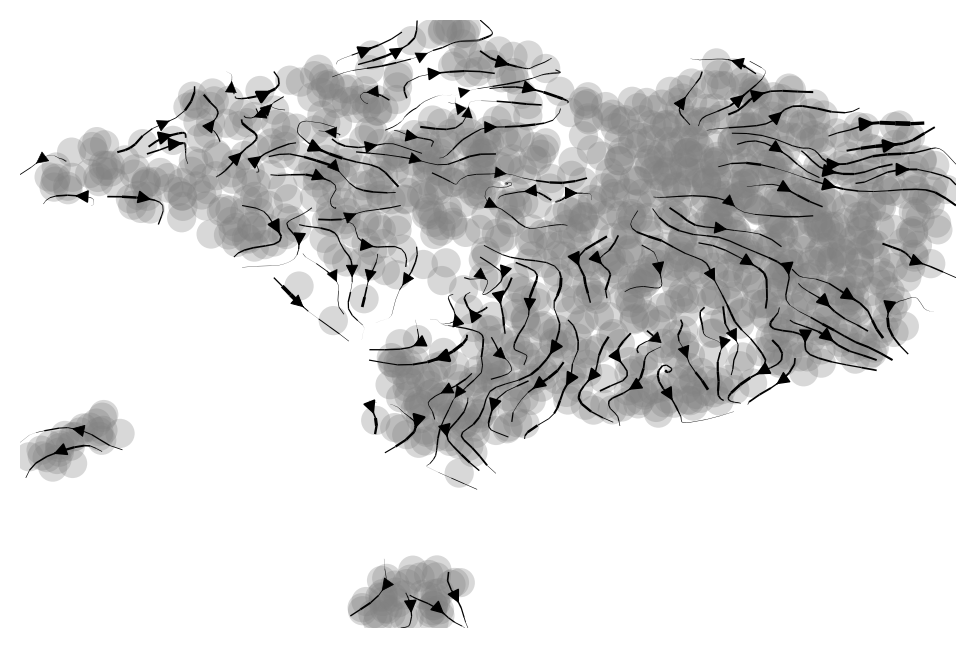

GPCCA[kernel=PseudotimeKernel[n=1322], initial_states=None, terminal_states=None]


In [65]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:01)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


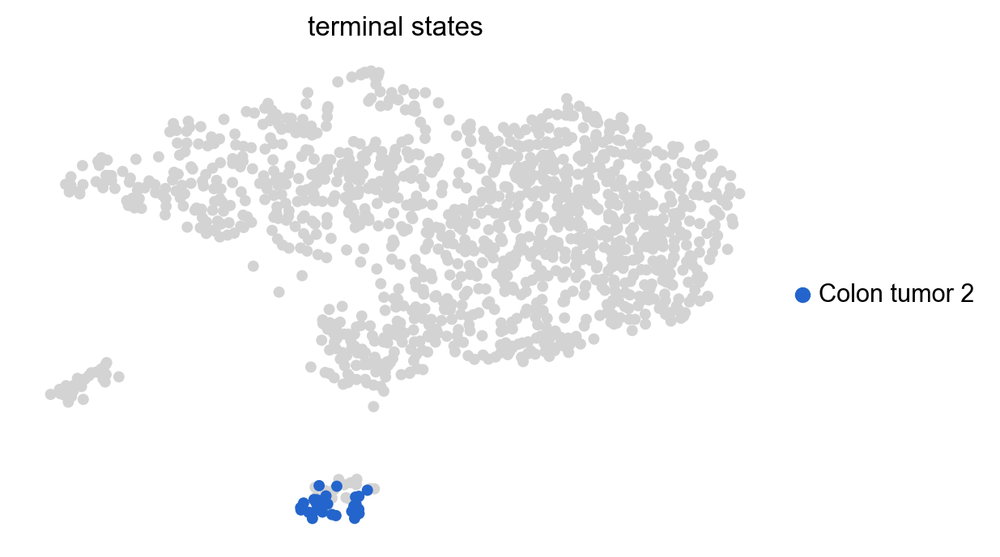

In [69]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Colon_tumor_2"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt07_cellrank.pdf


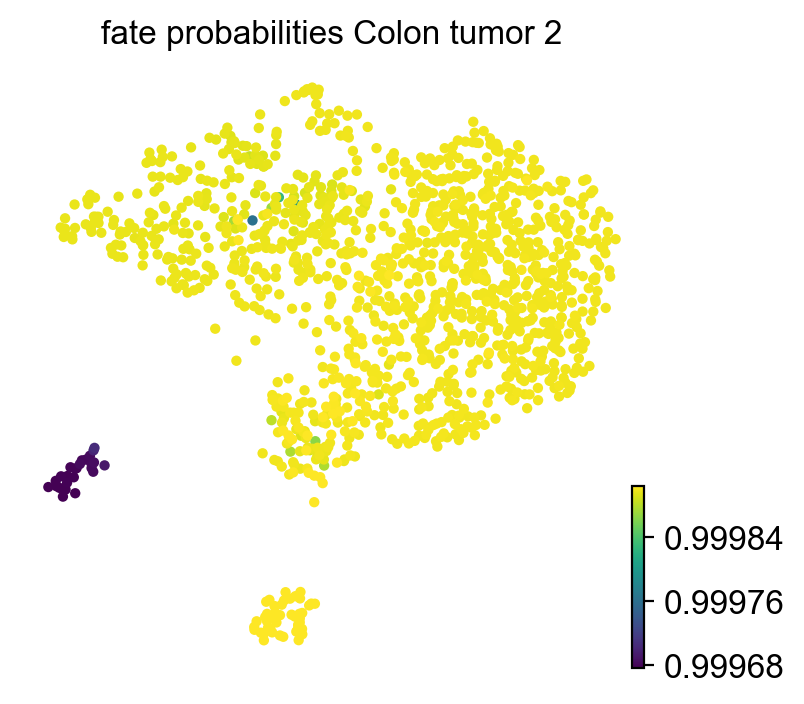

In [70]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt07_cellrank.pdf',figsize=(4,4))

In [71]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt07_cellrank.csv')

In [72]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt08.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

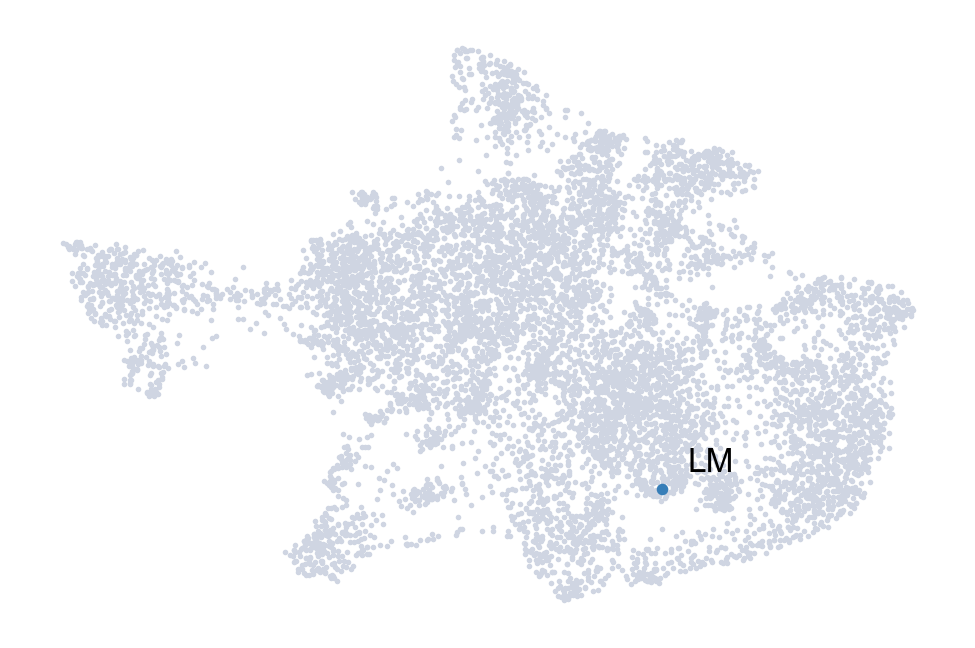

In [73]:
terminal_states = pd.Series(
    ["LM"],
    index=['X5226-5_CTCAGAAGTAGCGTGA-1'],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [74]:
start_cell = "X5226-2_GACCTGGTCCGCGCAA-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.011827747027079264 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.2007392168045044 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


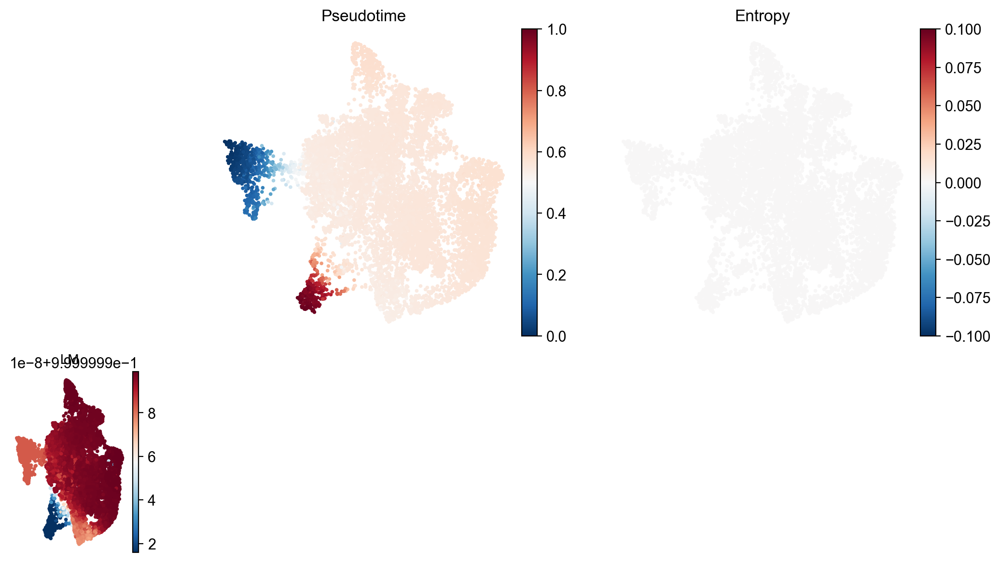

In [75]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/9313 [00:00<?, ?cell/s]

    Finish (0:00:03)
PseudotimeKernel[n=9313]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:03)


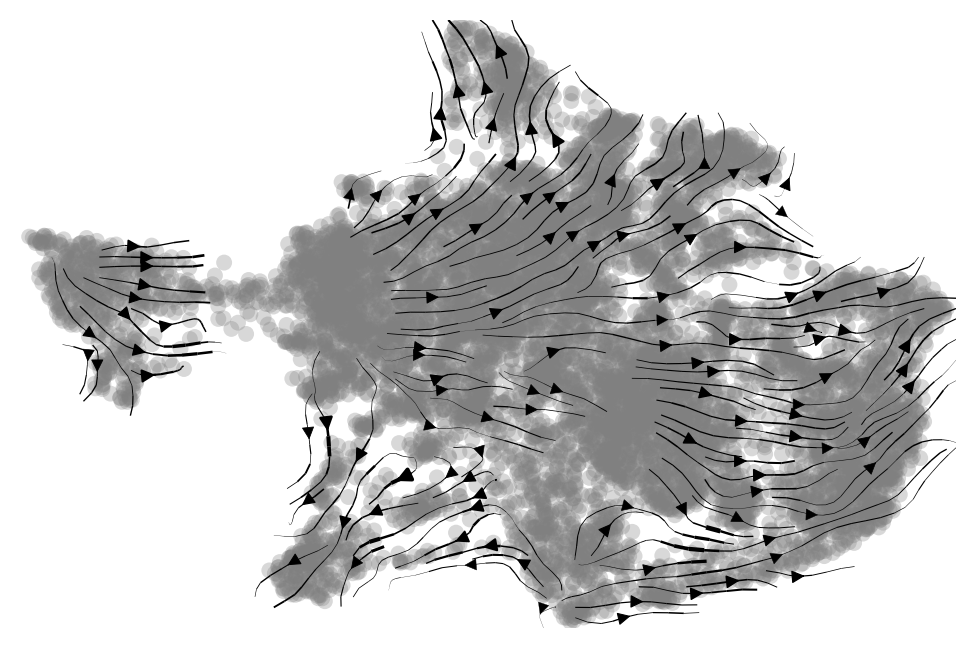

GPCCA[kernel=PseudotimeKernel[n=9313], initial_states=None, terminal_states=None]


In [76]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:03:37)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:07)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


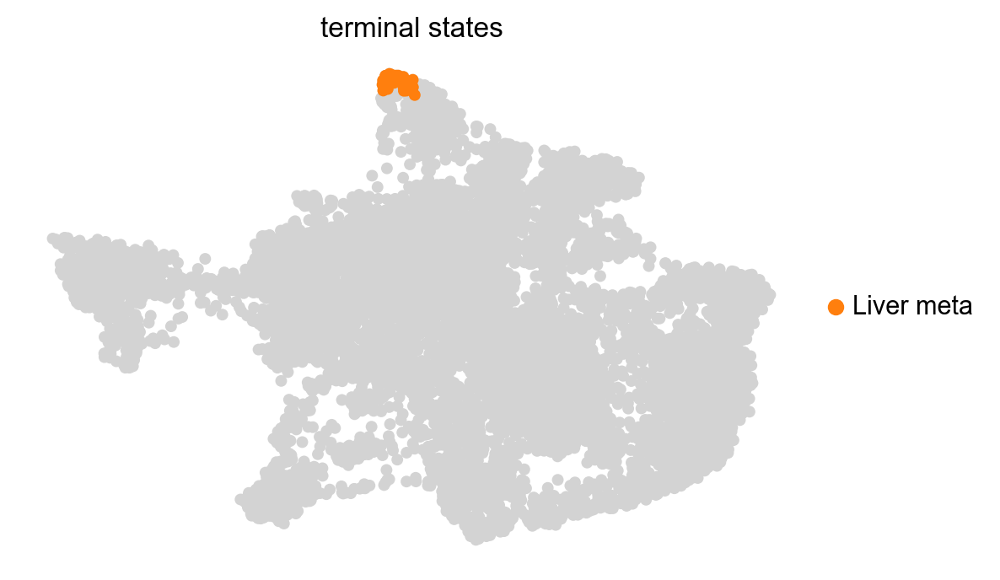

In [77]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:02:36)
saving figure to file ./figures/scvelo_Pt08_cellrank.pdf


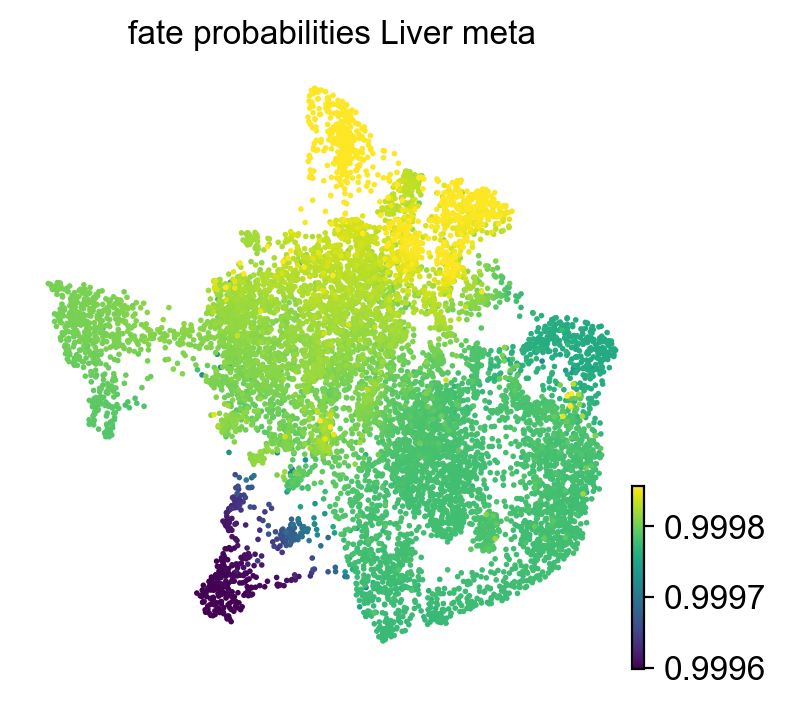

In [78]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt08_cellrank.pdf',figsize=(4,4))

In [79]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt08_cellrank.csv')

In [80]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt10.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

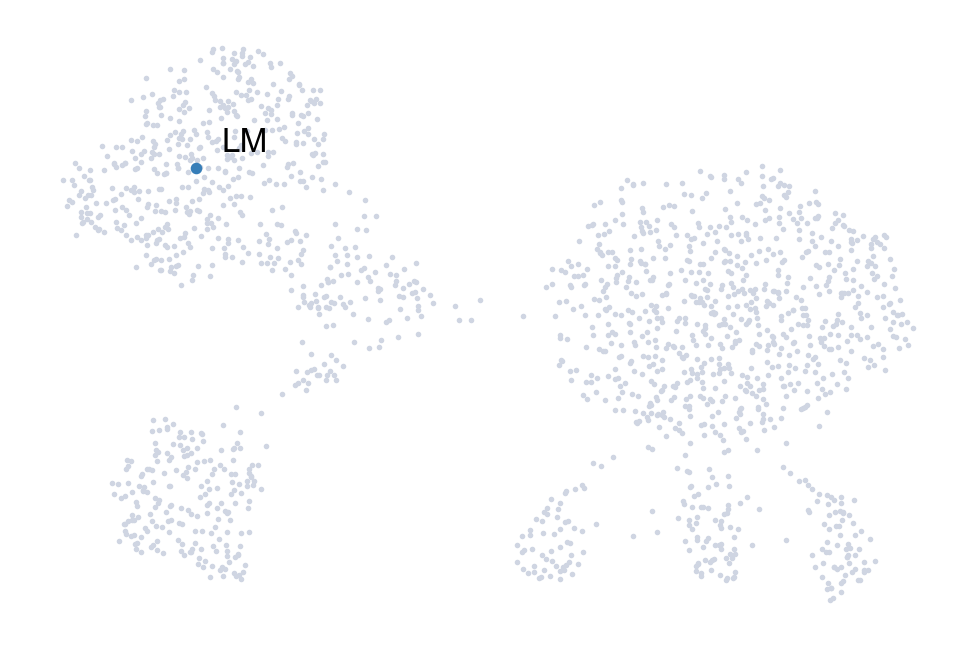

In [81]:
terminal_states = pd.Series(
    ["LM"],
    index=["M5208-2_AAGCCGCCAGGCAGTA-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [82]:
start_cell = "M5208-1_CGCTGGATCGATAGAA-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.0011907656987508138 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.09617196718851725 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


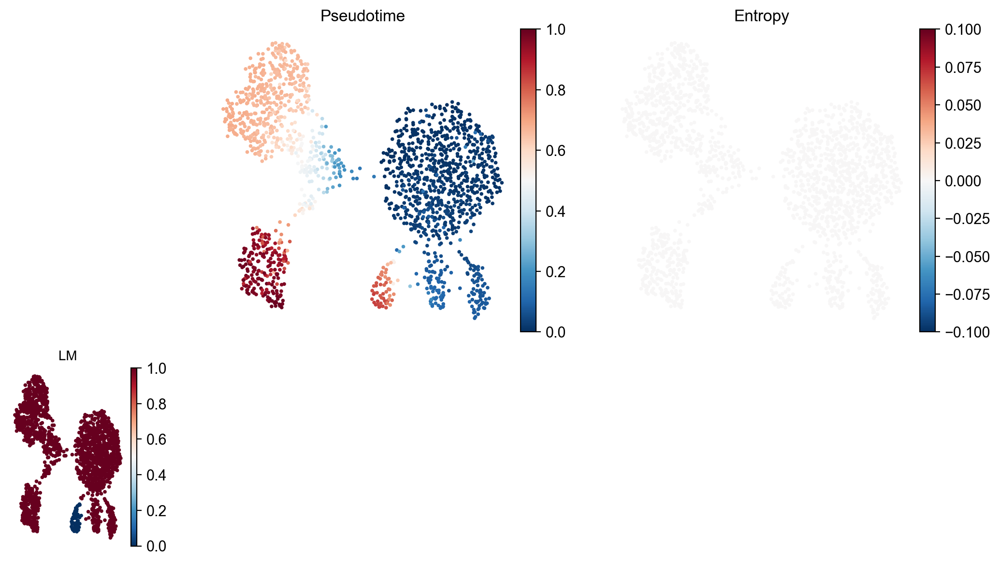

In [83]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/1764 [00:00<?, ?cell/s]

    Finish (0:00:00)
PseudotimeKernel[n=1764]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


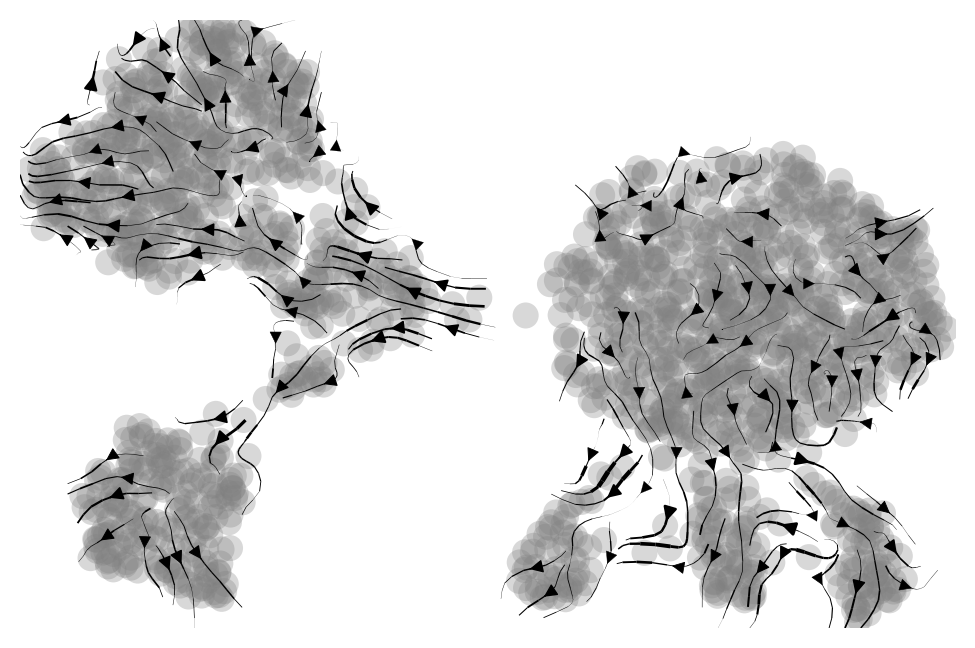

GPCCA[kernel=PseudotimeKernel[n=1764], initial_states=None, terminal_states=None]


In [84]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:02)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


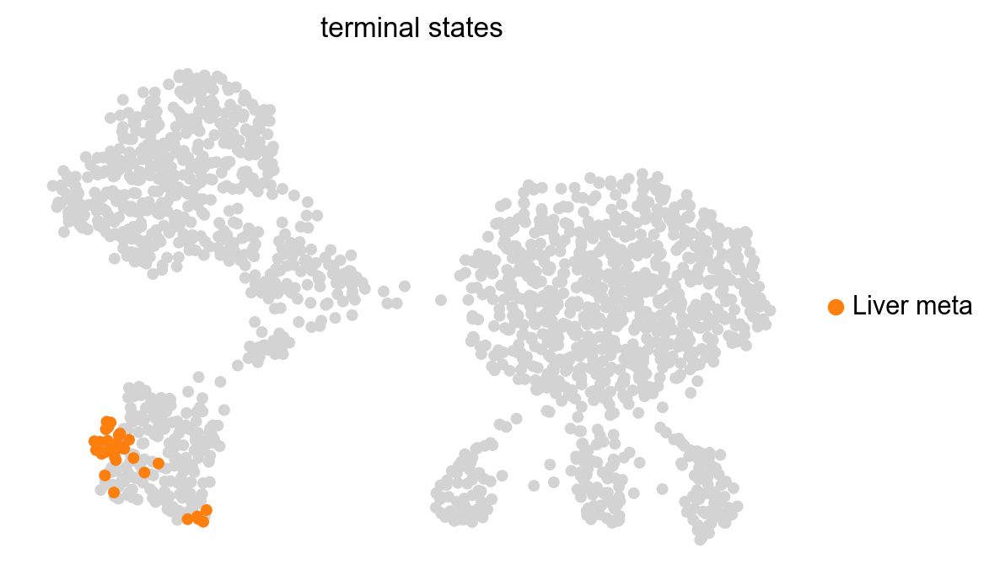

In [85]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt10_cellrank.pdf


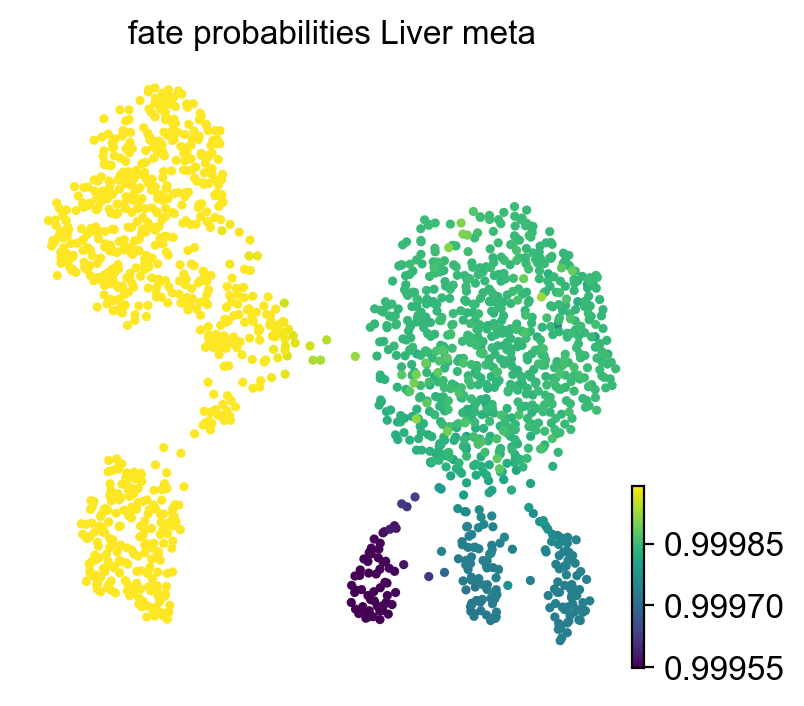

In [86]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt10_cellrank.pdf',figsize=(4,4))

In [87]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt10_cellrank.csv')

In [2]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt11.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

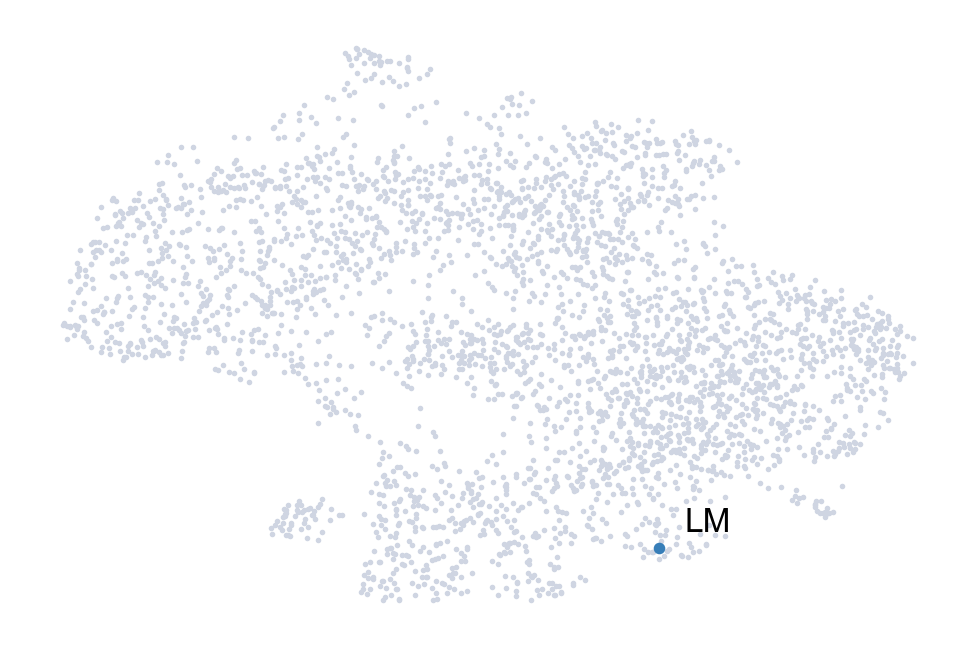

In [3]:
terminal_states = pd.Series(
    ["LM"],
    index=['M5213-1_TTCGGTCGTAGCGTAG-1'],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [4]:
start_cell = "M5213-3_TGCCCTATCCCTCAGT-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.006940281391143799 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.11740279992421468 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


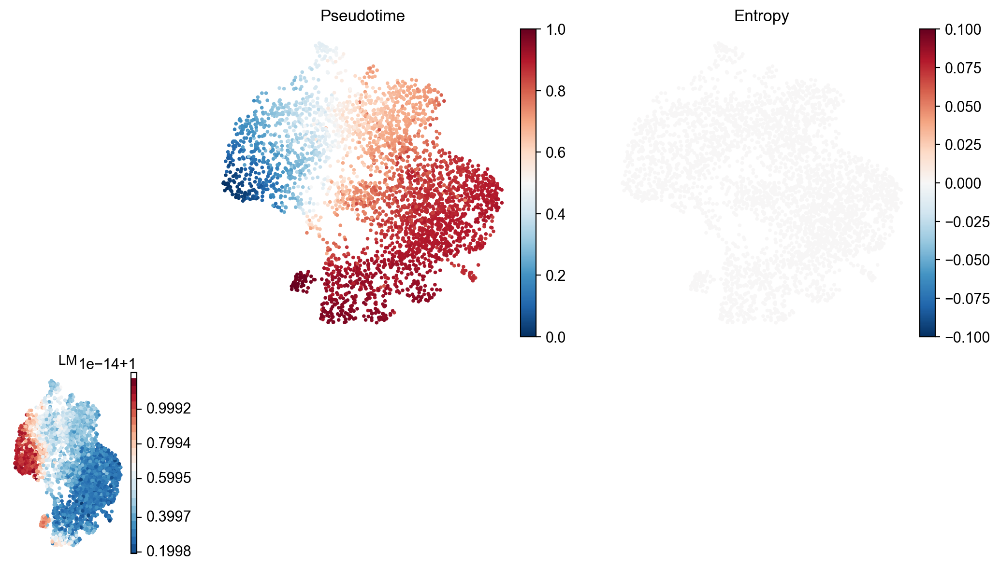

In [5]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/3427 [00:00<?, ?cell/s]

    Finish (0:00:01)
PseudotimeKernel[n=3427]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:01)


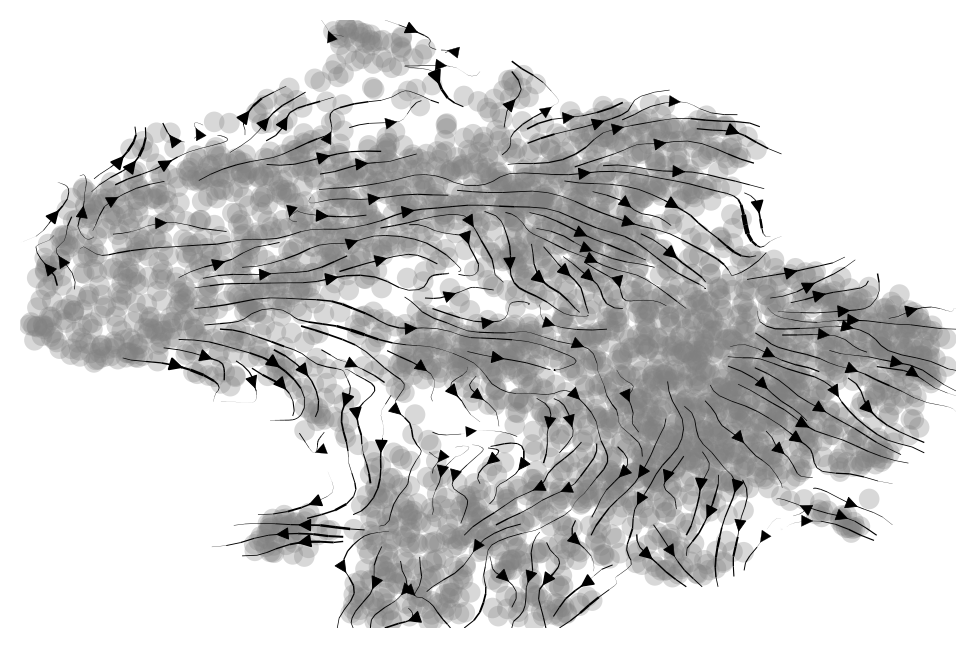

GPCCA[kernel=PseudotimeKernel[n=3427], initial_states=None, terminal_states=None]


In [6]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:14)
Computing `3` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


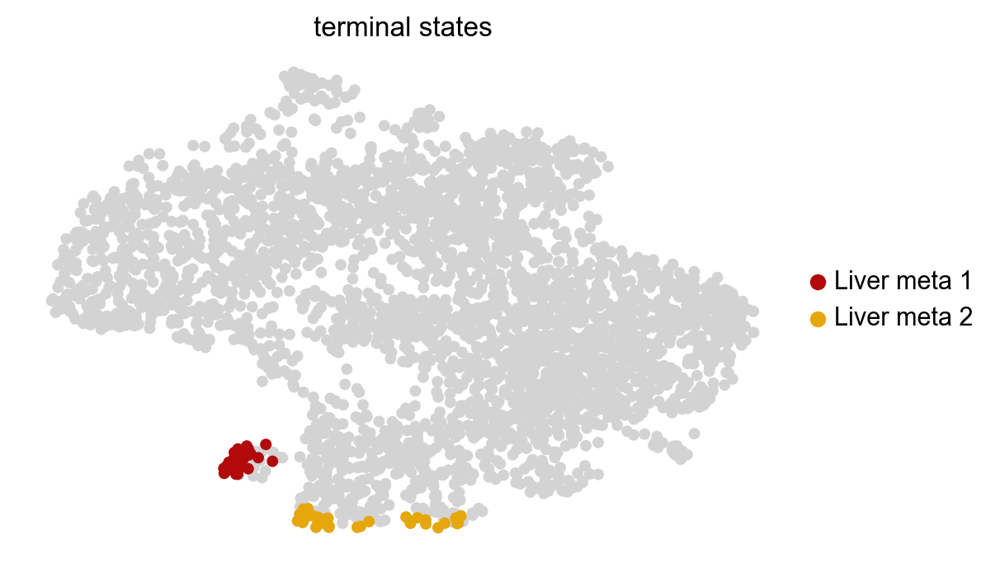

In [19]:
g.fit(cluster_key="lesions", n_states=3)

g.set_terminal_states(states=["Liver_meta_1","Liver_meta_2"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/2 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt11_cellrank.pdf


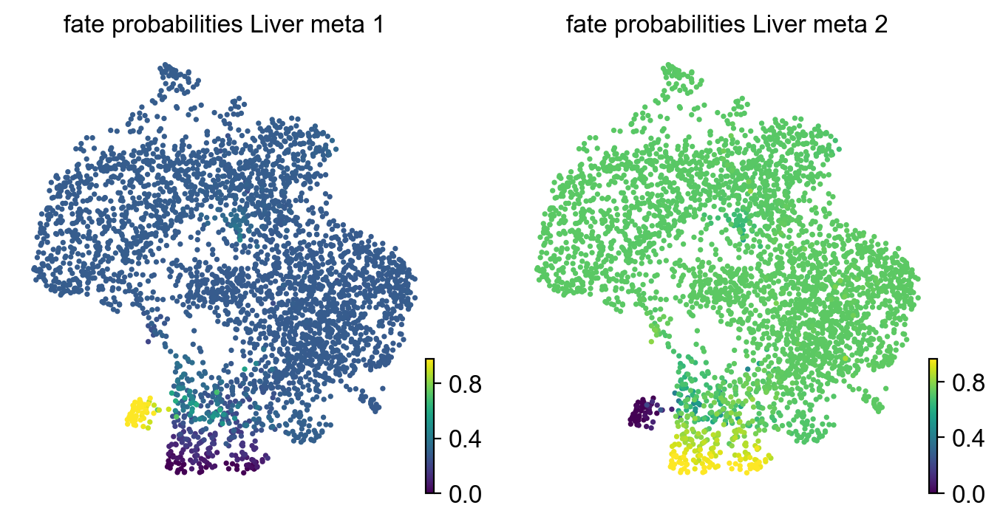

In [24]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt11_cellrank.pdf',figsize=(4,4))

In [25]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt11_cellrank.csv')

In [26]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt15.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

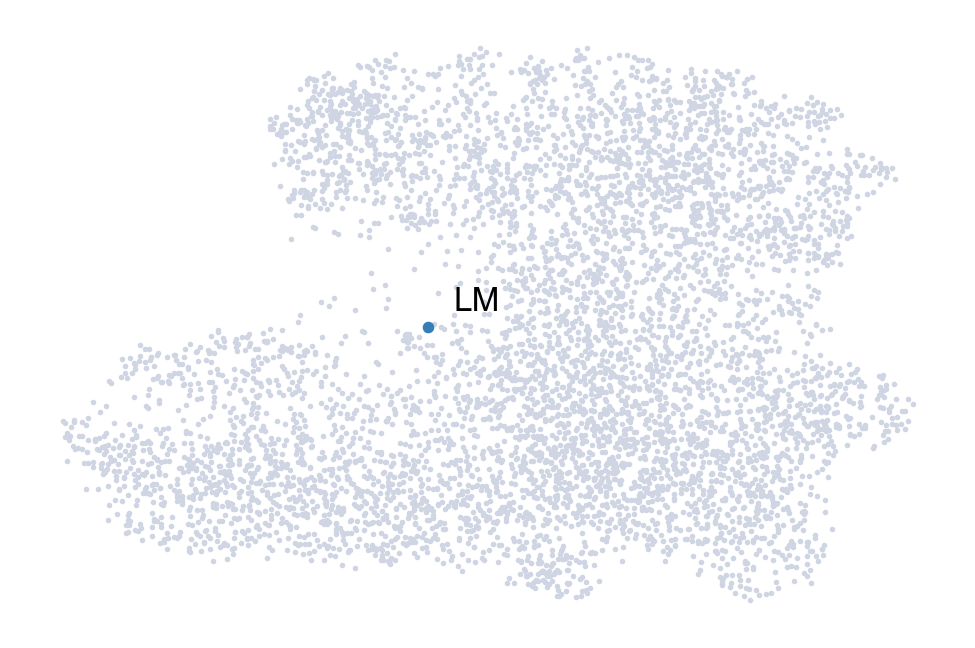

In [27]:
terminal_states = pd.Series(
    ["LM"],
    index=["P5215-1_AGCTTGACACGGTAGA-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [28]:
start_cell = "P5215-2_CTTAACTAGTGGACGT-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.006780584653218587 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.15197543303171793 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9999
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


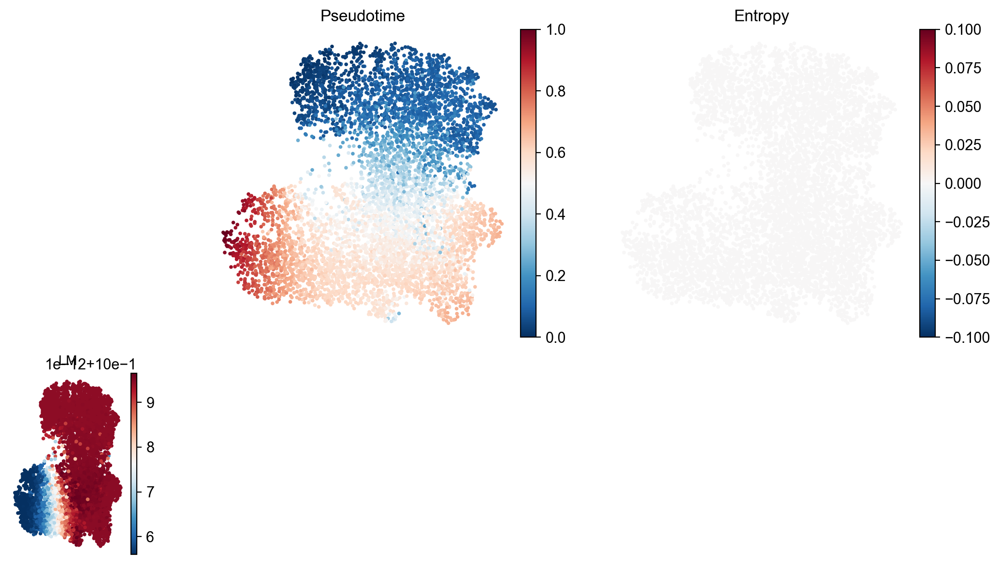

In [29]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/6260 [00:00<?, ?cell/s]

    Finish (0:00:02)
PseudotimeKernel[n=6260]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:01)


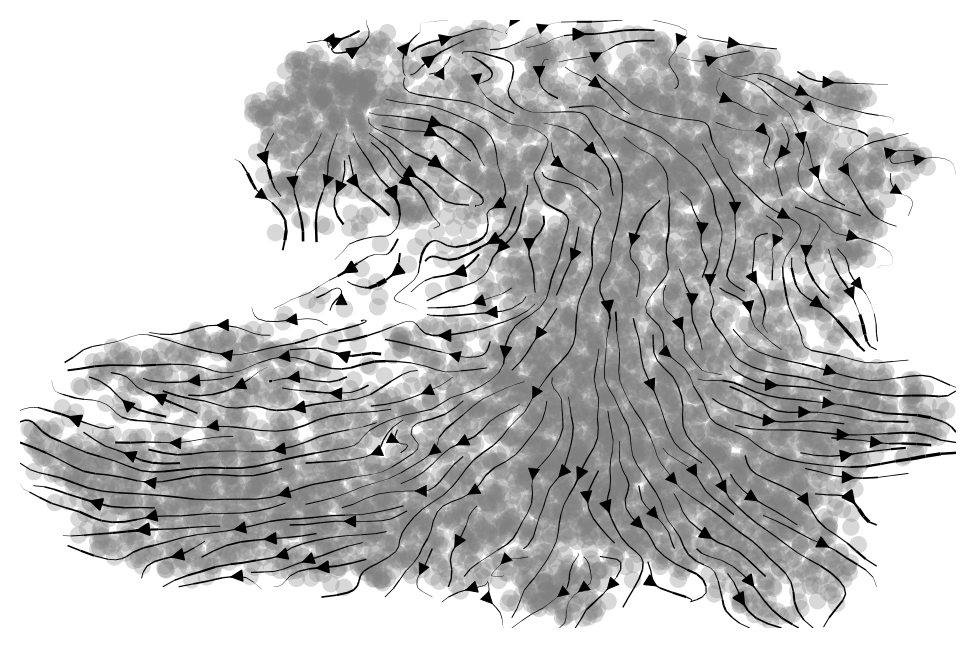

GPCCA[kernel=PseudotimeKernel[n=6260], initial_states=None, terminal_states=None]


In [30]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:01:16)
Computing `3` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:03)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


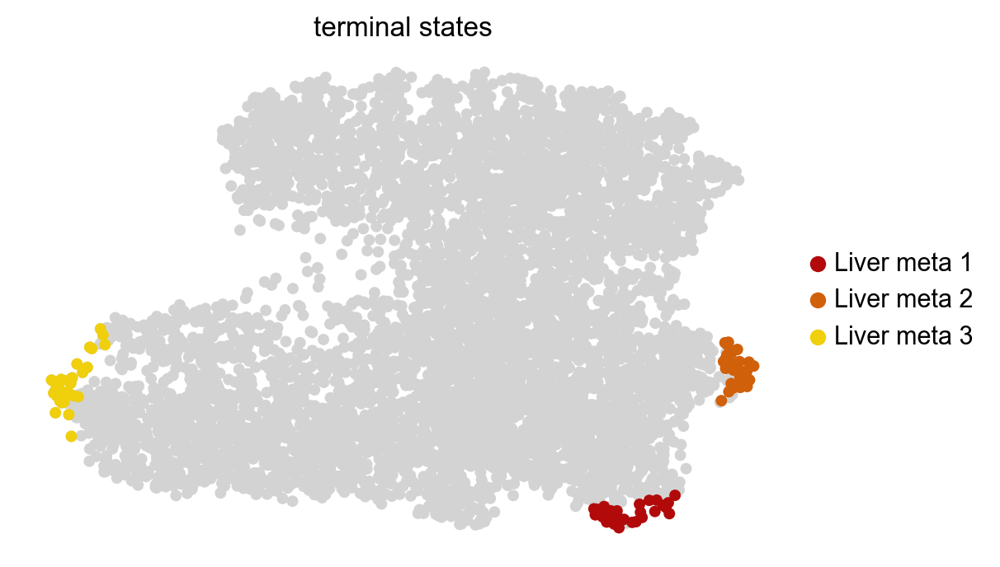

In [41]:
g.fit(cluster_key="lesions", n_states=3)

g.set_terminal_states(states=["Liver_meta_1","Liver_meta_2","Liver_meta_3"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/3 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt15_cellrank.pdf


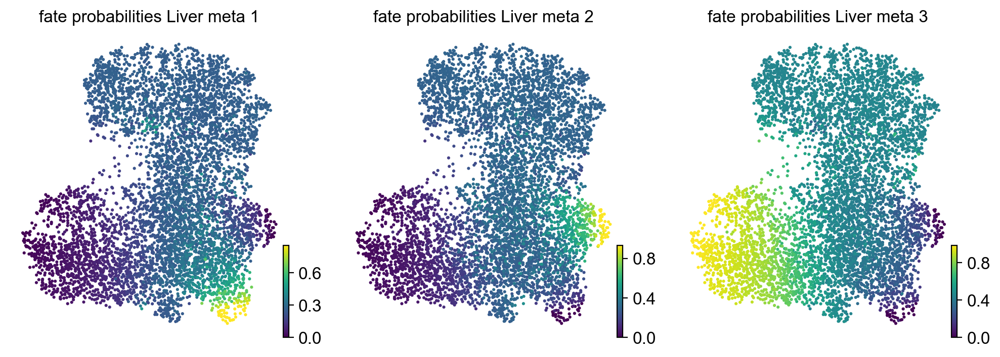

In [42]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt15_cellrank.pdf',figsize=(4,4))

In [44]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt15_cellrank.csv')

In [45]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt17.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

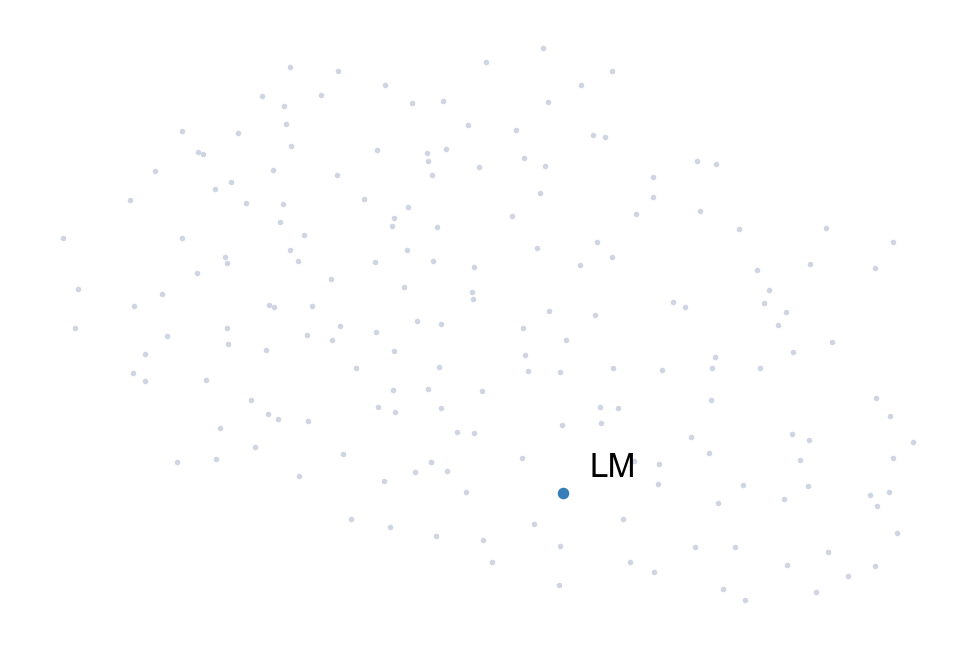

In [46]:
terminal_states = pd.Series(
    ["LM"],
    index=["Q5215-3_CACACCTCATACTCTT-1"],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [47]:
start_cell = "Q5215-1_ATCCACCAGCTGATAA-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.0004867672920227051 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.08935791254043579 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


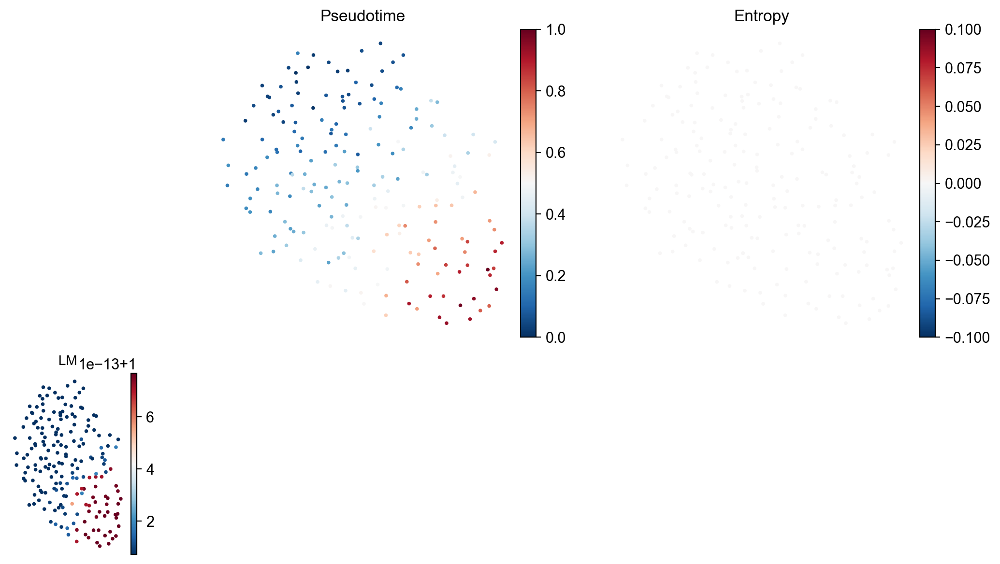

In [48]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/194 [00:00<?, ?cell/s]

    Finish (0:00:00)
PseudotimeKernel[n=194]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


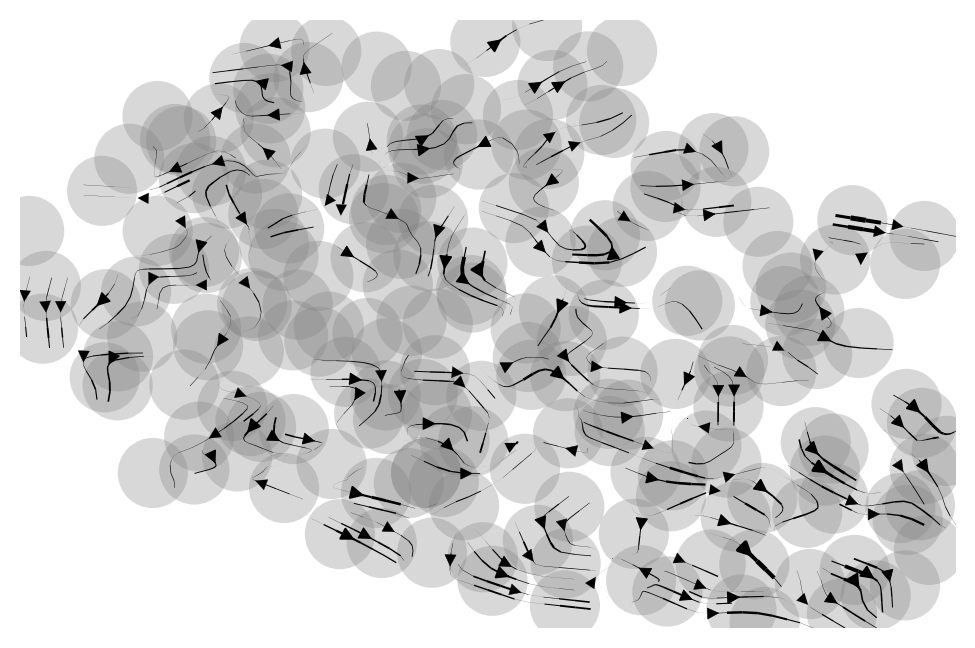

GPCCA[kernel=PseudotimeKernel[n=194], initial_states=None, terminal_states=None]


In [49]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


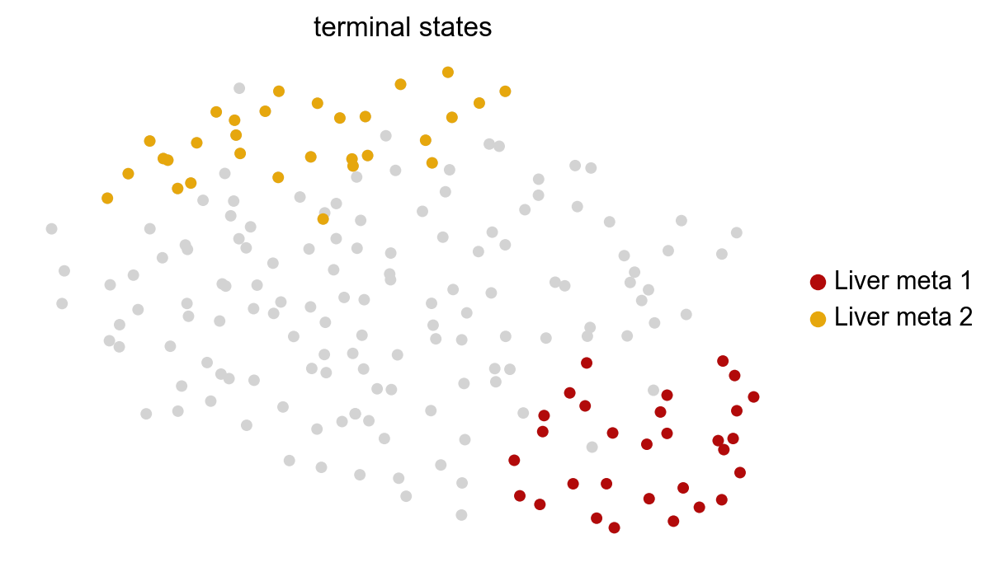

In [50]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta_1","Liver_meta_2"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/2 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt17_cellrank.pdf


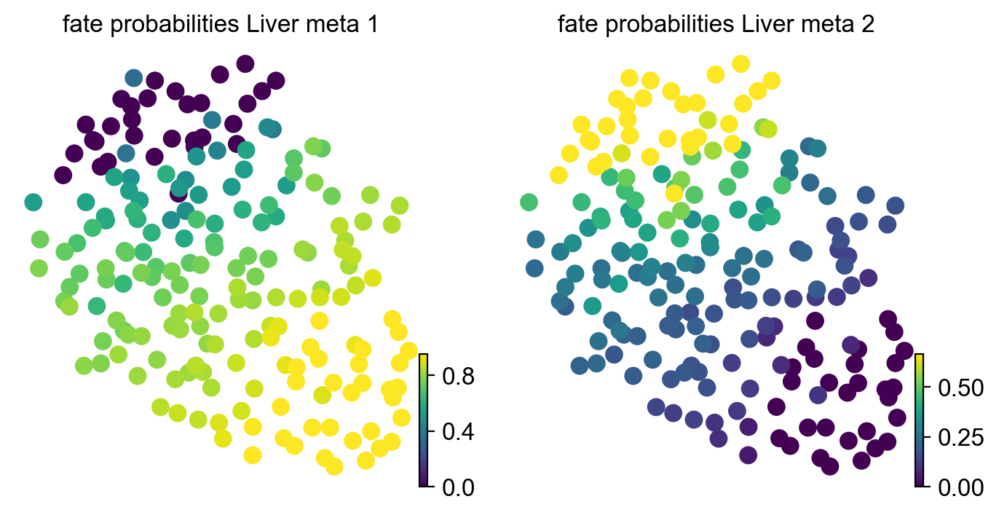

In [52]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt17_cellrank.pdf',figsize=(4,4))

In [53]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt17_cellrank.csv')

In [154]:
# Load sample data
data_dir = os.path.expanduser("./")
file_path = os.path.join(data_dir, "Pt18.h5ad")
ad = sc.read(file_path)
ad
sc.pp.highly_variable_genes(ad, n_top_genes=1500, flavor="cell_ranger")
sc.pp.pca(ad)
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(ad, n_components=5)
ms_data = palantir.utils.determine_multiscale_space(ad)
sc.pp.neighbors(ad)
sc.tl.umap(ad)
imputed_X = palantir.utils.run_magic_imputation(ad)

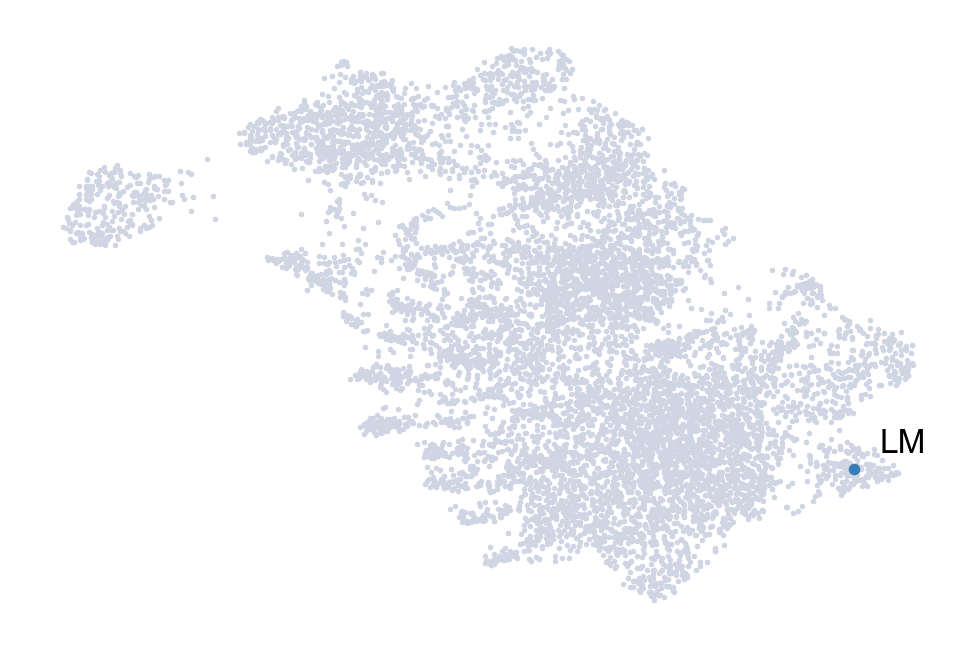

In [155]:
terminal_states = pd.Series(
    ["LM"],
    index=['R5218-2_TTTGTCAGTAAGTTCC-1'],
)
palantir.plot.highlight_cells_on_umap(ad, terminal_states)
plt.show()

In [156]:
start_cell = "R5218-3_GACGTGCAGAGATGAG-1"
pr_res = palantir.core.run_palantir(
    ad, start_cell, num_waypoints=500, terminal_states=terminal_states
)

Sampling and flocking waypoints...
Time for determining waypoints: 0.009313646952311199 minutes
Determining pseudotime...
Shortest path distances using 30-nearest neighbor graph...
Time for shortest paths: 0.16882928212483725 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


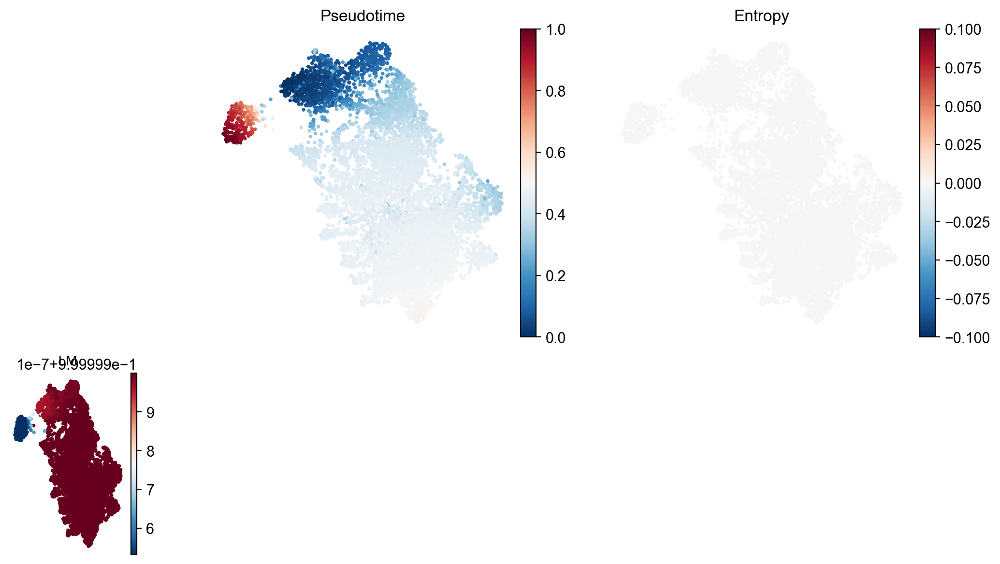

In [157]:
palantir.plot.plot_palantir_results(ad, s=3)
plt.show()

Computing transition matrix based on pseudotime


  0%|          | 0/8848 [00:00<?, ?cell/s]

    Finish (0:00:03)
PseudotimeKernel[n=8848]
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:02)


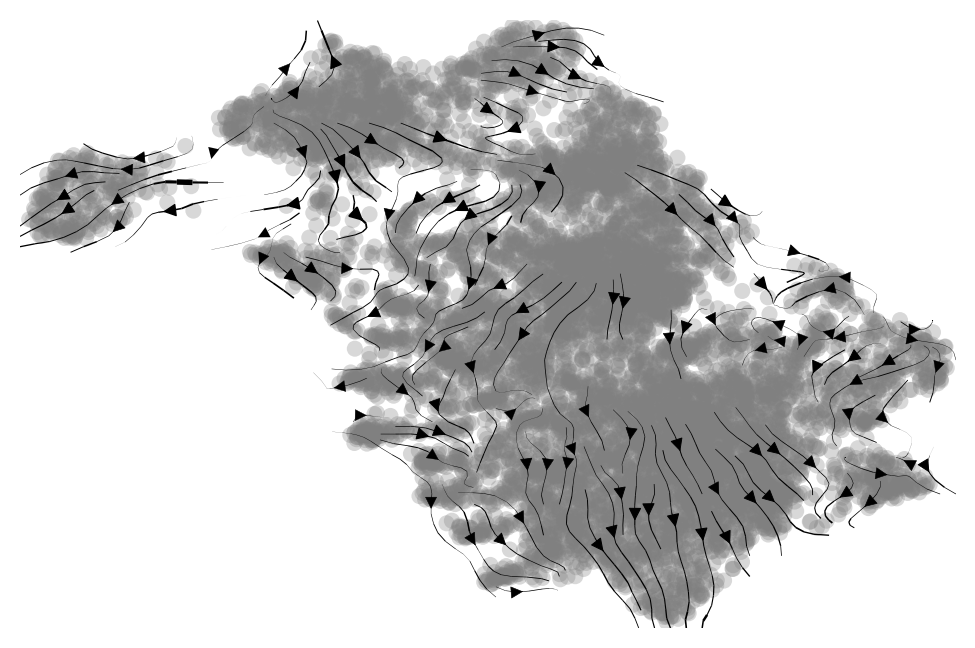

GPCCA[kernel=PseudotimeKernel[n=8848], initial_states=None, terminal_states=None]


In [158]:
sc.tl.diffmap(ad)
pk = cr.kernels.PseudotimeKernel(ad, time_key="palantir_pseudotime")
pk.compute_transition_matrix()

print(pk)
pk.plot_projection(basis="umap", recompute=True)
g = cr.estimators.GPCCA(pk)
print(g)

Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:02:58)
Computing `2` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:06)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


/Users/shiyue/miniconda3/envs/scrna/lib/python3.8/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


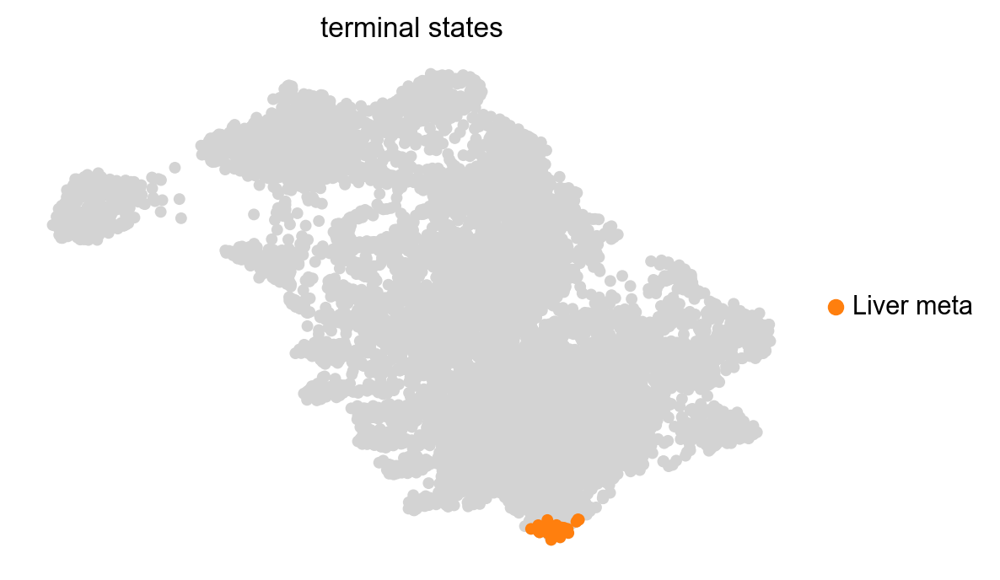

In [159]:
g.fit(cluster_key="lesions", n_states=2)

g.set_terminal_states(states=["Liver_meta"])
g.plot_macrostates(which="terminal", legend_loc="right", size=100)

Computing fate probabilities


  0%|          | 0/1 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)
saving figure to file ./figures/scvelo_Pt18_cellrank.pdf


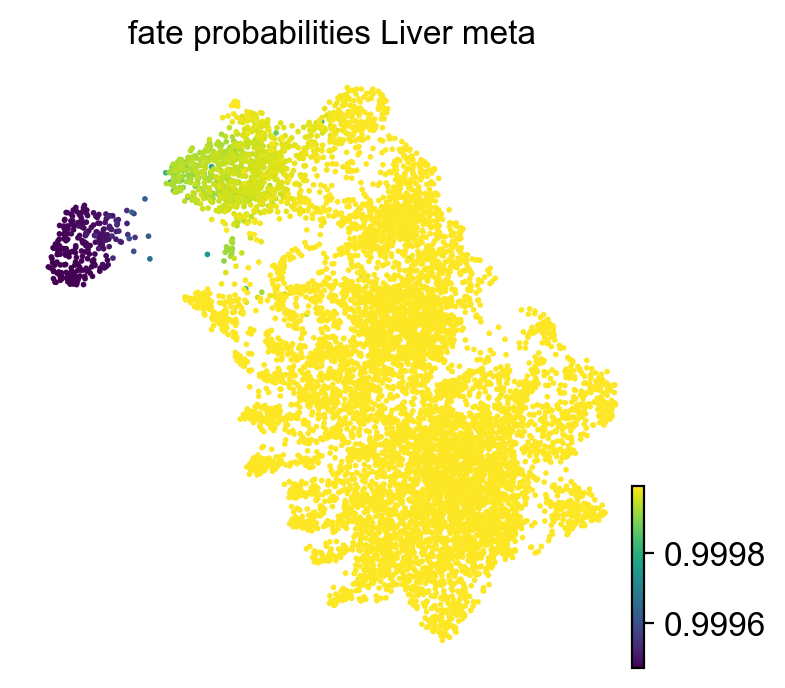

In [161]:
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False,save='Pt18_cellrank.pdf',figsize=(4,4))

In [162]:
ad.obs[['palantir_pseudotime', 'EMT_score','lesions','patient','term_states_fwd_probs']].to_csv('Pt18_cellrank.csv')